# Master File

This notebook runs the GP backtest, NN-IV training and backtesting, SSVI backtesting and trinomial tree backtesting. Finally all results are compared.

#### Help on Importing files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from the "code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use the neural network while avoiding the training step.
- csv files in "Results" folder if you want to load Results presented in our paper.


In [2]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
from IPython.display import display
import sklearn as skl

import sys
formerPath = sys.path
sys.path.append('./code/')
sys.path.append('./BS/')

import os
formerStdOut = sys.stdout

import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import SSVIUnconstrained
import neuralNetwork
import experiments


import importlib
plt.rcParams['figure.dpi'] = 50

In [3]:
sys.stdout = formerStdOut

# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

#### Load preformatted data ("Reload")

You should execute that cell, if you want to keep the same training set and testing set as those used in the paper.

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

#### DAX Data ("DAX")

For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.
- "8_8_2001__filterdax.dat" for tikohnov local volatility.

#### From DAX data from .dat files ("DAX dat files")
For a day x you must load :
- "x.dat.modelparam.dat"
- "x.dat.impliedvol.dat"
- "x.dat.calibr.out.dat"
- "x.dat"

#### SPX Data ("SPX")

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

####  Eurostoxx data ("Eurostoxx")

File required : Data_EuroStoxx50_20190110_all_for_Marc.xlsx

# Formatting data

### Boostsrapping Rate Curve

We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [4]:
data = experiments.loadAndFormatData("Reload")
dataSet, dataSetTest, S0, bootstrap, KMin, KMax, midS0, scaler, scaledDataSet, scaledDataSetTest, volLocaleGridDf = data

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


# Neural Network : Learning Implied volatility
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [43]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0.0
hyperparameters["lambdaSoft"] = 0.0 
hyperparameters["lambdaGamma"] = 0.0

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.0001
hyperparameters["lowerBoundGamma"] = 0.0

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 0.70

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 200
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = True
hyperparameters["nbEpochFork"] = 0
hyperparameters["lambdaFork"] = 0.0
hyperparameters["HolderExponent"] =  4.0

Training w.r.t. implied vol RMSE and arbitrage constraints
Iteration :  4029 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 4030): -3.81
Best Penalization :  [0.022153122, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  5259 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 5260): -3.99
Best Penalization :  [0.018555146, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  5459 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 5460): -3.99
Best Penalization :  [0.018555146, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  5659 new learning rate :  1.0000000000000002e-06
Best loss (hidden nodes: 100, iterations: 5660): -3.99
Best Penalization :  [0.018555146, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0]]
Iteration :  5859 new learning rate :  1.0000000000000002e-07
Best loss (hidden nodes: 100, iterations: 5860): -3.99
Be

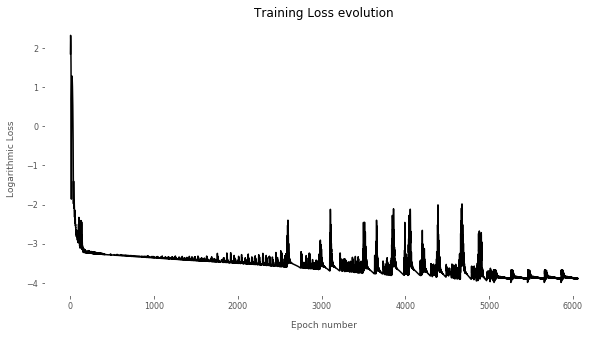

In [5]:
res = experiments.trainNeuralNetworkImpliedVolatility(dataSet, 
                                                      hyperparameters, 
                                                      scaler, 
                                                      False)
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): -3.98
Best Penalization :  [0.018555146, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[3.912631e-06, 0.00015963847]]
Refined Grid evaluation :
Number of arbitrage violation :  749
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


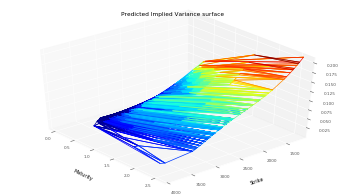

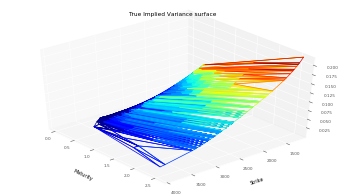

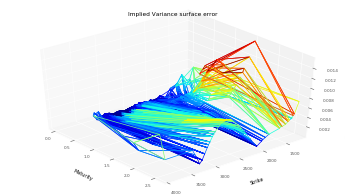

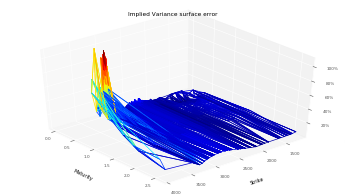

RMSE :  0.001749926158536668
RMSE Relative:  0.20556659447273404


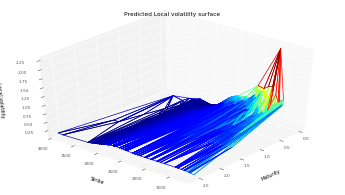

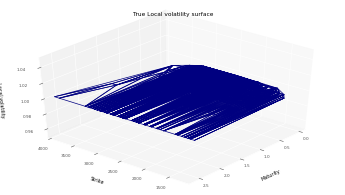

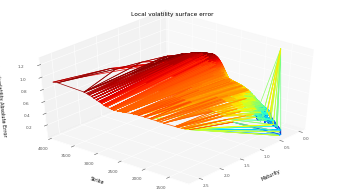

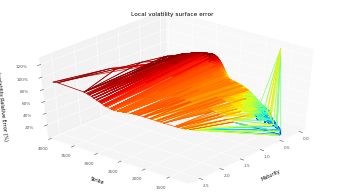

RMSE :  0.7356795656479247
RMSE Relative:  0.7356795656479247


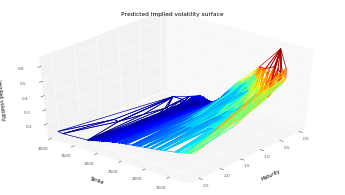

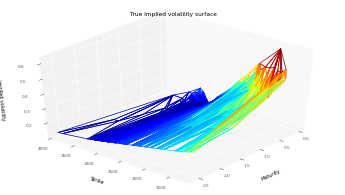

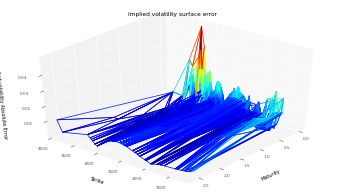

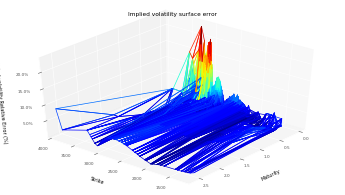

RMSE :  0.00843605550463775
RMSE Relative:  0.04985642375602925


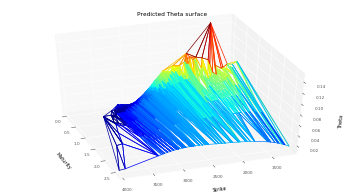

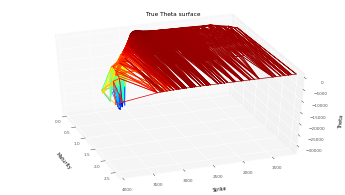

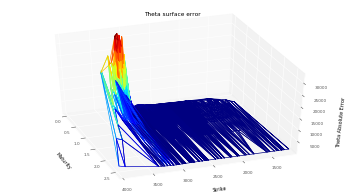

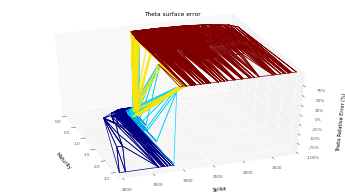

RMSE :  5822.4400270391125
RMSE Relative:  0.9992833896637886


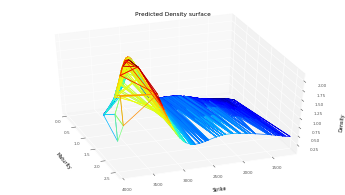

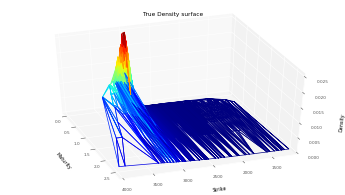

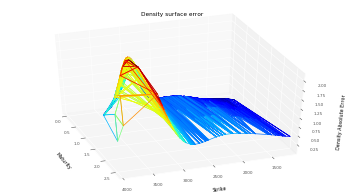

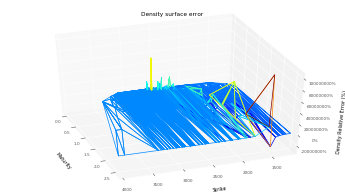

RMSE :  0.7696443670271449
RMSE Relative:  39975.14378506508


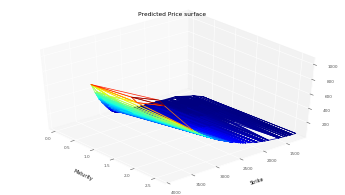

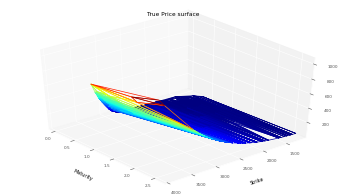

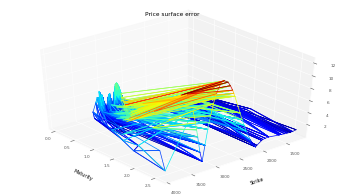

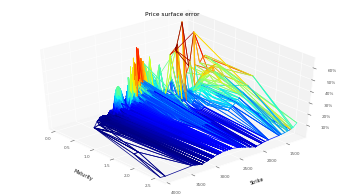

RMSE :  2.163086886598594
RMSE Relative:  0.1281286395470346
ATM Local Volatility : 
Strike  Maturity
2860.0  0.055       0.122177
        0.074       0.122301
        0.082       0.122782
        0.093       0.124118
        0.370       0.151556
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


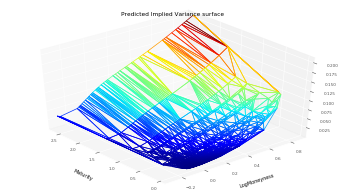

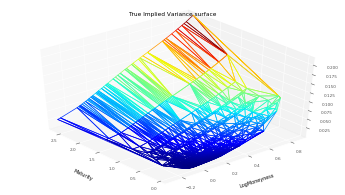

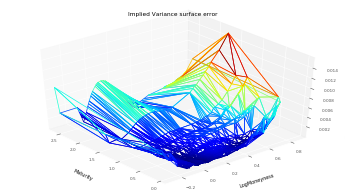

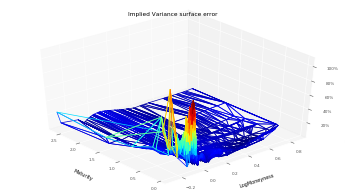

RMSE :  0.001749926158536668
RMSE Relative:  0.20556659447273404


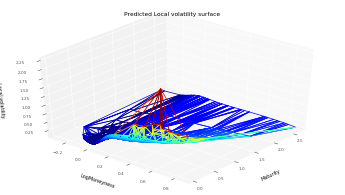

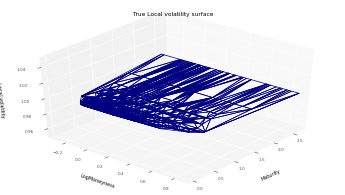

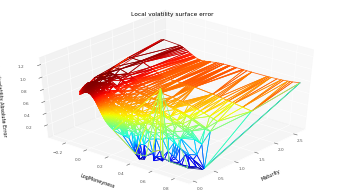

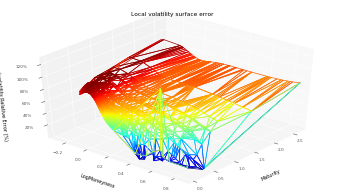

RMSE :  0.7356795656479247
RMSE Relative:  0.7356795656479247


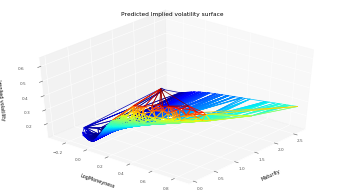

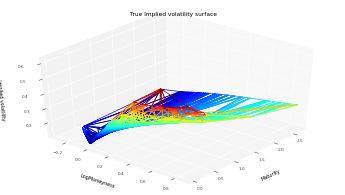

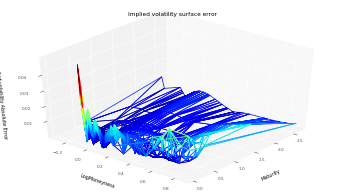

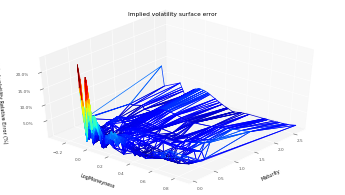

RMSE :  0.00843605550463775
RMSE Relative:  0.04985642375602925


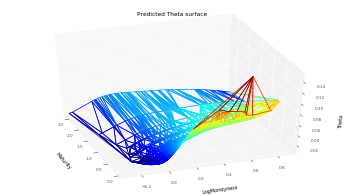

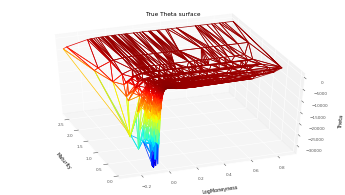

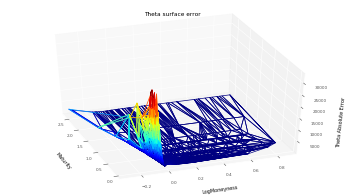

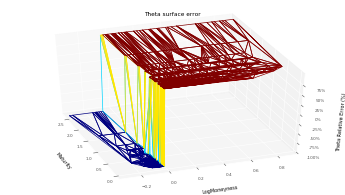

RMSE :  5822.4400270391125
RMSE Relative:  0.9992833896637886


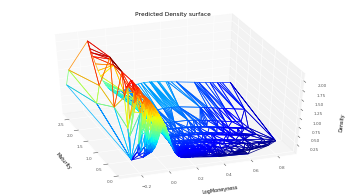

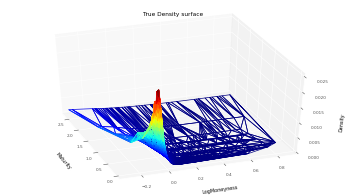

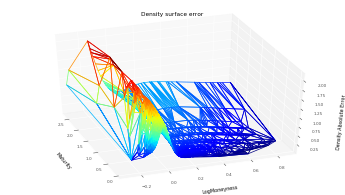

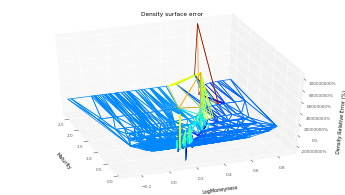

RMSE :  0.7696443670271449
RMSE Relative:  39975.14378506508


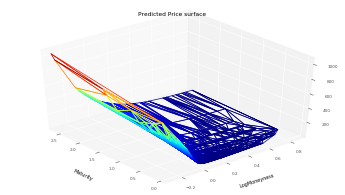

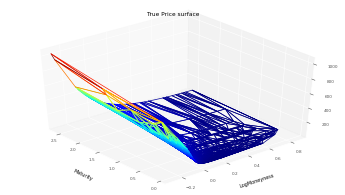

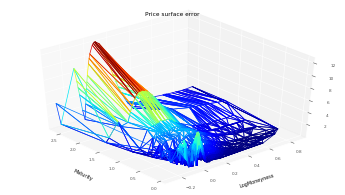

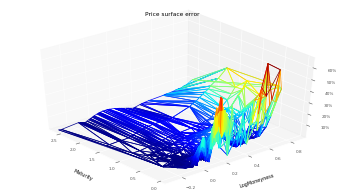

RMSE :  2.163086886598594
RMSE Relative:  0.1281286395470346
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): -3.97
Best Penalization :  [0.018649515, 0.0, [0.0, 0.0]]
Best Penalization (Refined Grid):  [[3.860166e-06, 0.00015749785]]
Refined Grid evaluation :
Number of arbitrage violation :  749
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


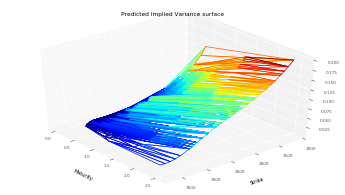

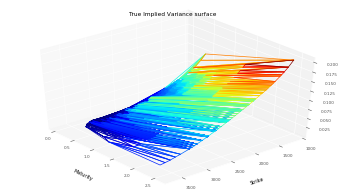

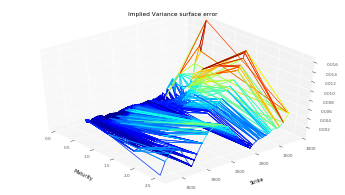

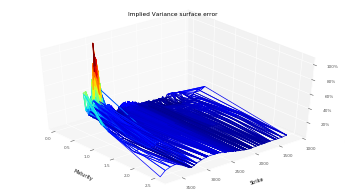

RMSE :  0.0018171287616403381
RMSE Relative:  0.187912989007356


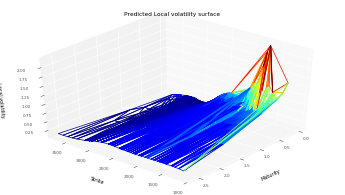

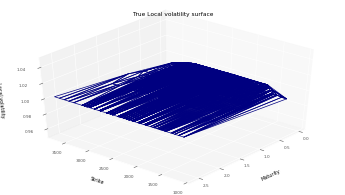

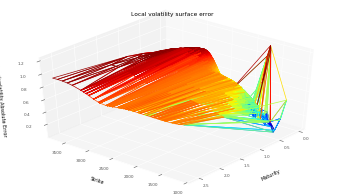

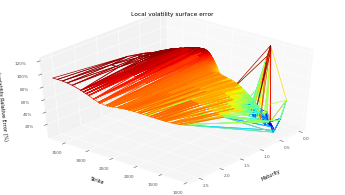

RMSE :  0.7350536201218512
RMSE Relative:  0.7350536201218512


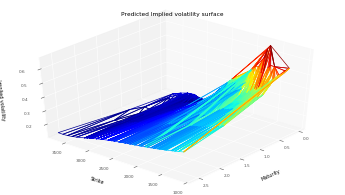

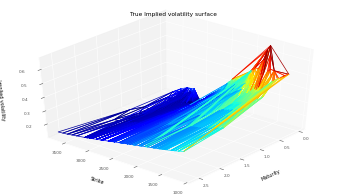

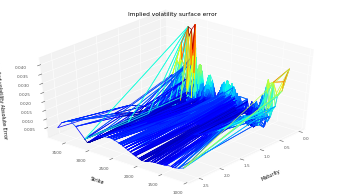

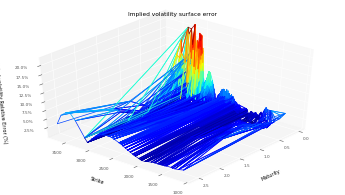

RMSE :  0.008567944367217762
RMSE Relative:  0.04875571240035937


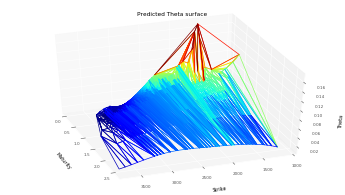

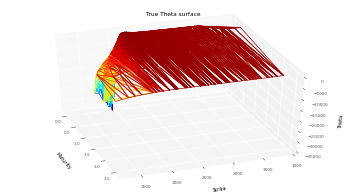

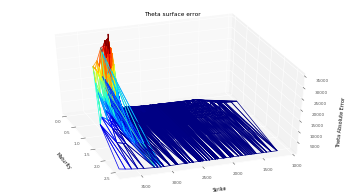

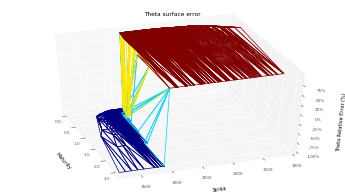

RMSE :  5770.470607881711
RMSE Relative:  0.9991880761709704


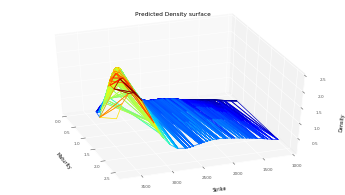

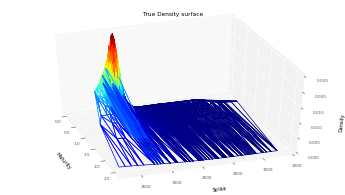

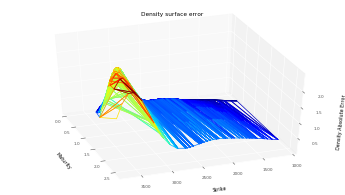

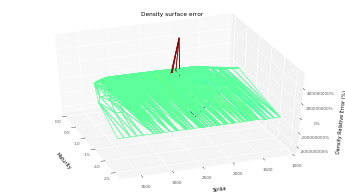

RMSE :  0.7985715596829471
RMSE Relative:  185019.33916668457


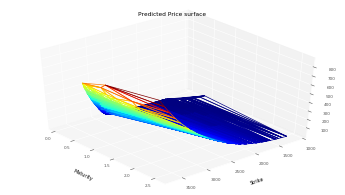

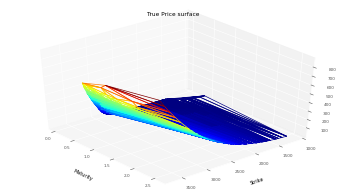

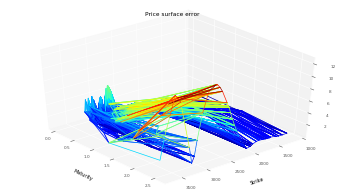

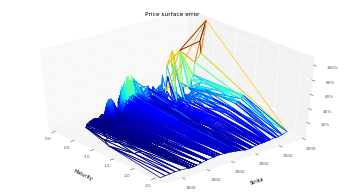

RMSE :  2.0449254768585936
RMSE Relative:  0.1375298220603711
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


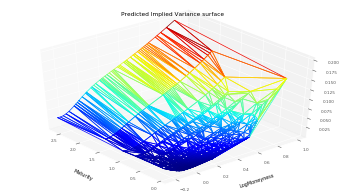

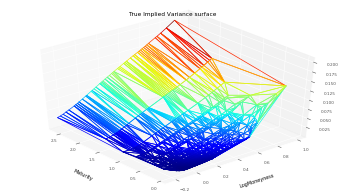

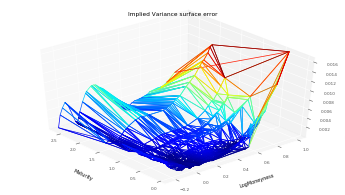

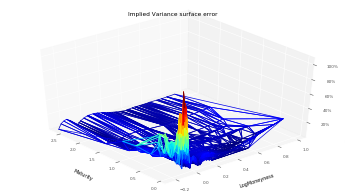

RMSE :  0.0018171287616403381
RMSE Relative:  0.187912989007356


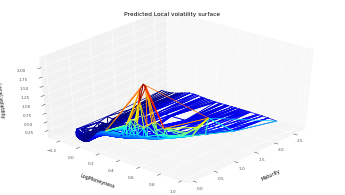

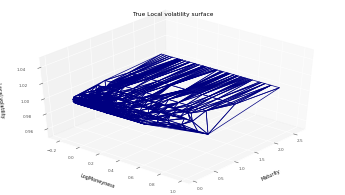

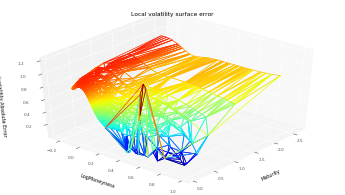

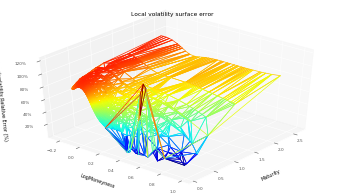

RMSE :  0.7350536201218512
RMSE Relative:  0.7350536201218512


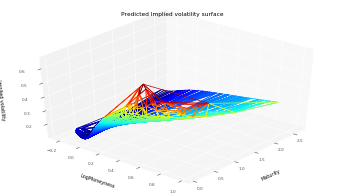

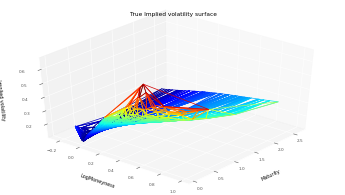

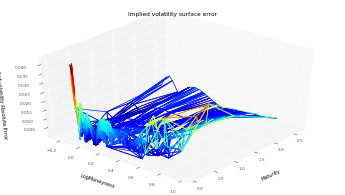

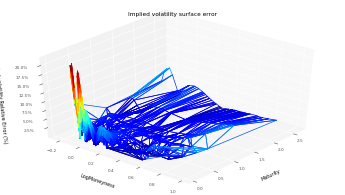

RMSE :  0.008567944367217762
RMSE Relative:  0.04875571240035937


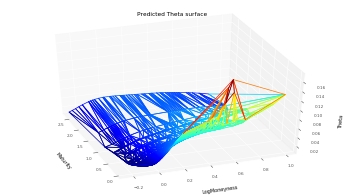

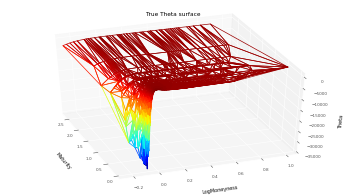

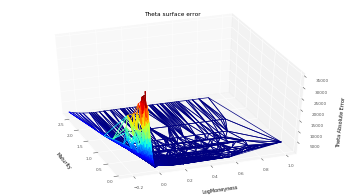

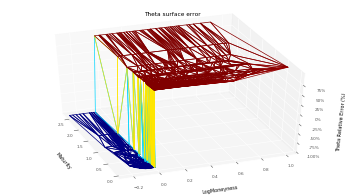

RMSE :  5770.470607881711
RMSE Relative:  0.9991880761709704


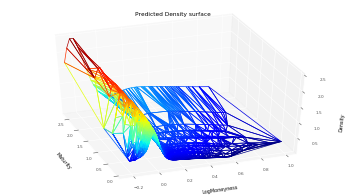

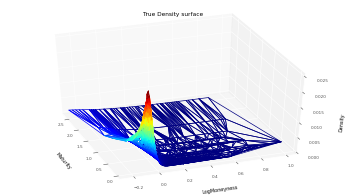

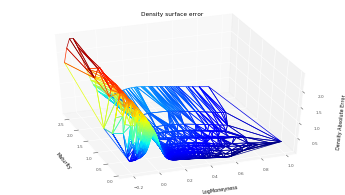

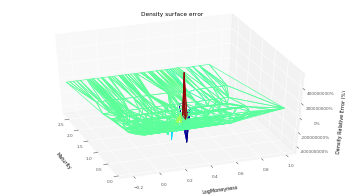

RMSE :  0.7985715596829471
RMSE Relative:  185019.33916668457


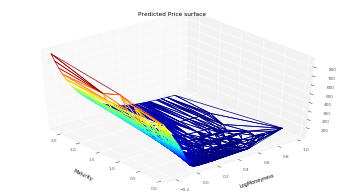

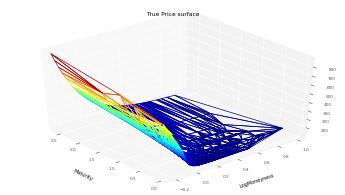

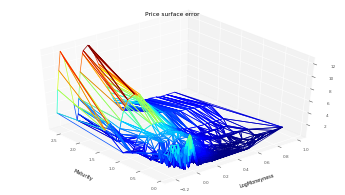

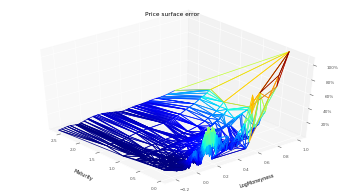

RMSE :  2.0449254768585936
RMSE Relative:  0.1375298220603711


In [44]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableImpliedVolatility(dataSet, 
                                                                                 dataSetTest,
                                                                                 hyperparameters,
                                                                                 scaler,
                                                                                 KMin,
                                                                                 KMax,
                                                                                 S0, midS0,
                                                                                 bootstrap)

#### With arbitrage constraint

In [4]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 1.0
hyperparameters["lambdaSoft"] = 100.0 
hyperparameters["lambdaGamma"] = 10000.0

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.000001
hyperparameters["lowerBoundGamma"] = 0.0

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 1.00

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 200
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = True
hyperparameters["nbEpochFork"] = 0
hyperparameters["lambdaFork"] = 0.0
hyperparameters["HolderExponent"] =  2.0

/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Training w.r.t. implied vol RMSE and arbitrage constraints
Iteration :  780 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 781): -4.88
Best Penalization :  [0.0073606824, 0.0, [0.0, 0.0, 1.1658915e-06]]
Best Penalization (Refined Grid) :  [[0.00020473248, 0.0, 4.001752e-05]]
Iteration :  3959 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 3960): -5.28
Best Penalization :  [0.005064029, 0.0, [0.0, 0.0, 2.0210173e-05]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 3.4667428e-05]]
Iteration :  4159 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 4160): -5.28
Best Penalization :  [0.005064029, 0.0, [0.0, 0.0, 2.0210173e-05]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 3.4667428e-05]]
Iteration :  4359 new learning rate :  1.0000000000000002e-06
Best loss (hidden nodes: 100, iterations: 4360): -5.28
Best Penalization :  [0.005064029, 0.0, [0.0, 0.0, 2.0210173e-05]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 3.46674

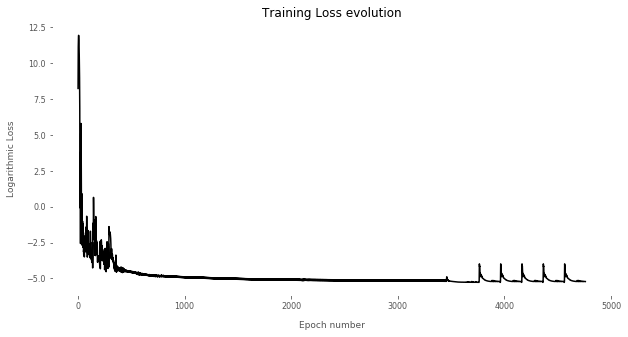

In [5]:
res = experiments.trainNeuralNetworkImpliedVolatility(dataSet, 
                                                      hyperparameters, 
                                                      scaler, 
                                                      True)
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): -5.28
Best Penalization :  [0.005064029, 0.0, [0.0, 0.0, 2.0210173e-05]]
Best Penalization (Refined Grid):  [[0.0, 0.0, 3.4667428e-05]]
Refined Grid evaluation :
Number of arbitrage violation :  0
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


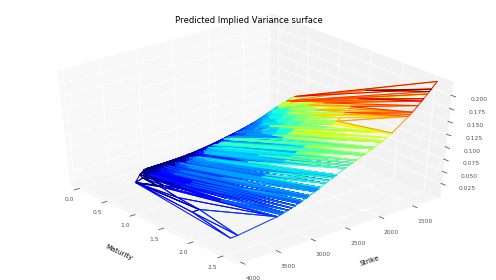

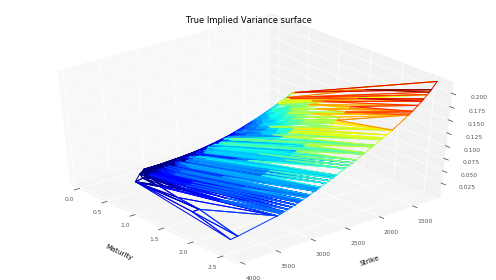

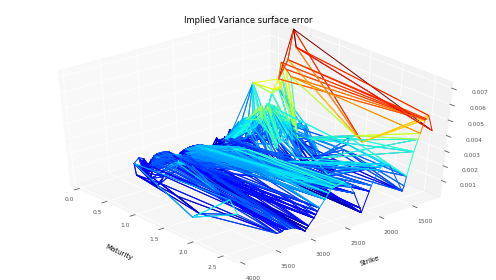

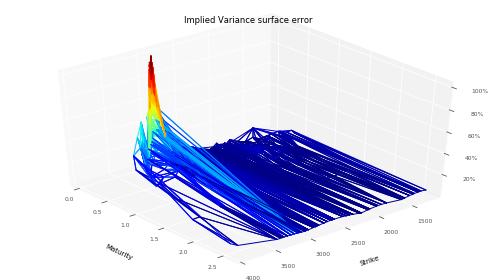

RMSE :  0.0010724708305405795
RMSE Relative:  0.23891686292776612


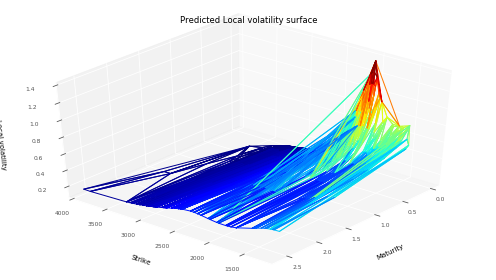

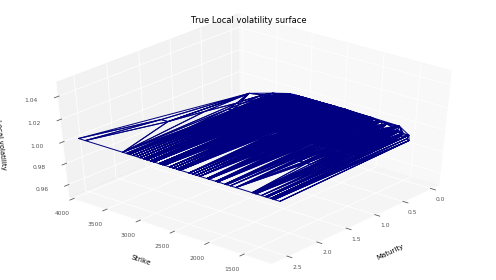

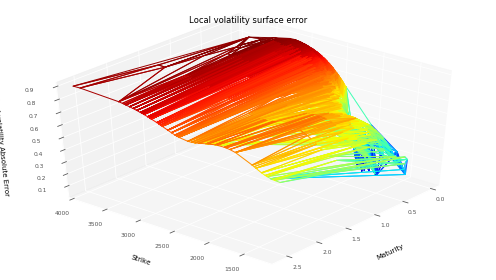

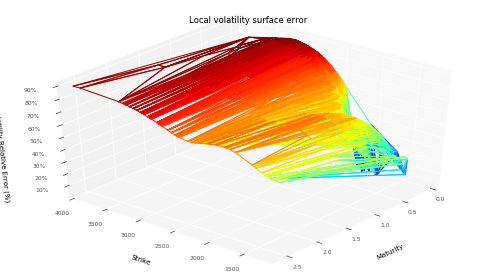

RMSE :  0.7501610614309917
RMSE Relative:  0.7501610614309917


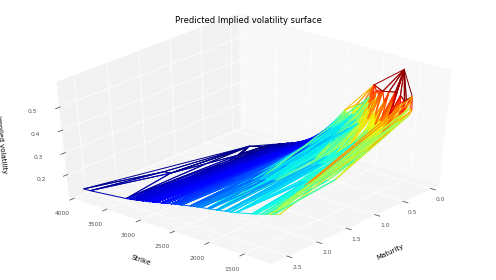

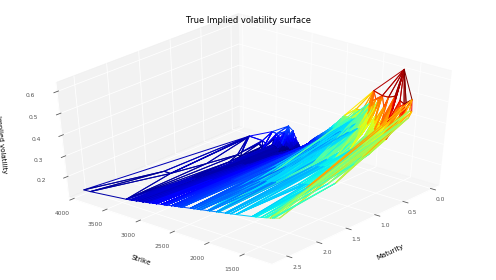

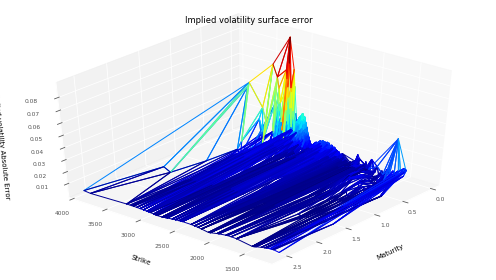

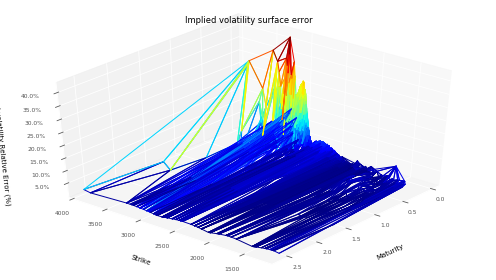

RMSE :  0.012264854215540202
RMSE Relative:  0.08327867545601328


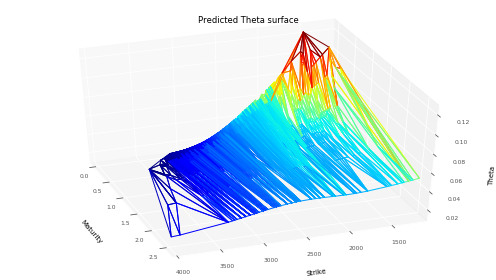

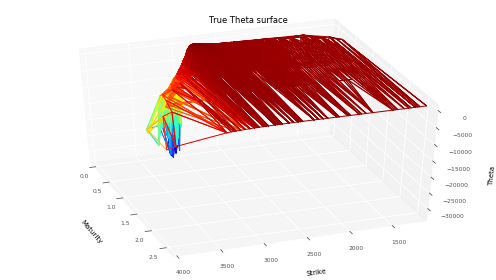

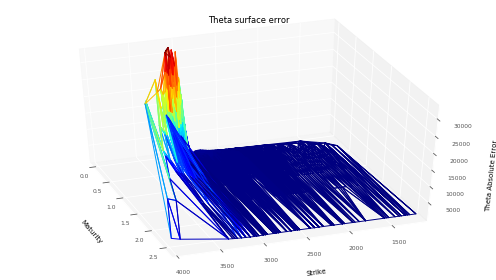

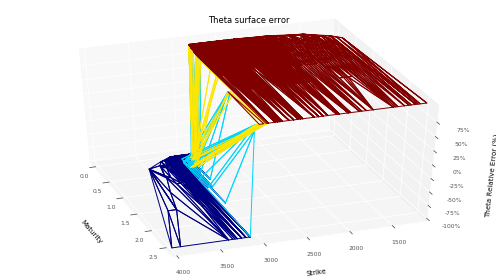

RMSE :  5822.441340828603
RMSE Relative:  0.9992754296971398


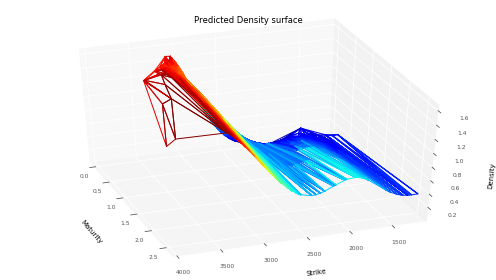

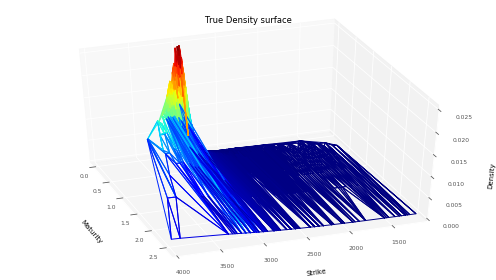

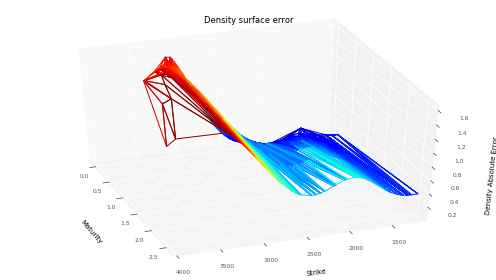

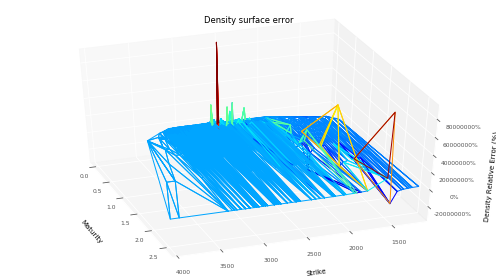

RMSE :  0.8394729572800232
RMSE Relative:  41045.37934372894


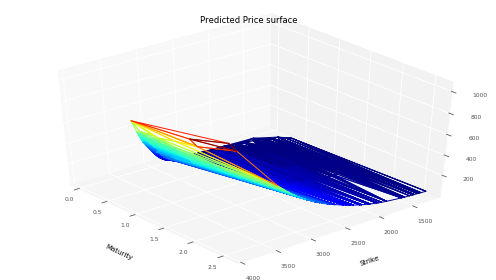

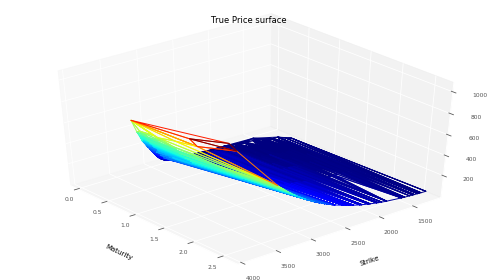

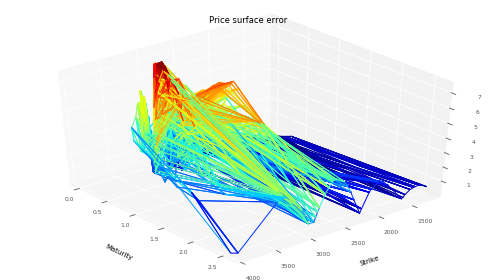

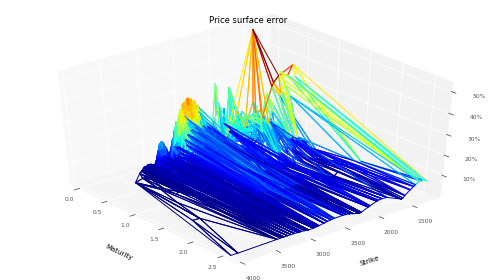

RMSE :  2.8970278269535044
RMSE Relative:  0.10653629664256535
ATM Local Volatility : 
Strike  Maturity
2860.0  0.055       0.127063
        0.074       0.136264
        0.082       0.138030
        0.093       0.139814
        0.370       0.142318
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


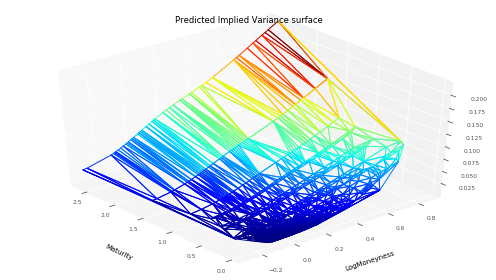

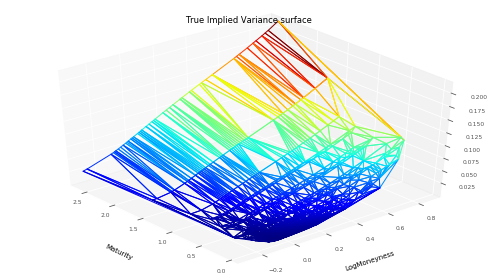

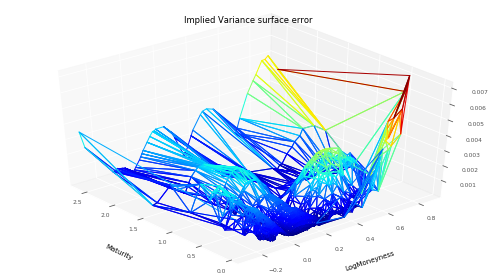

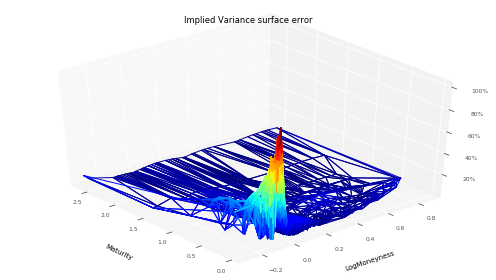

RMSE :  0.0010724708305405795
RMSE Relative:  0.23891686292776612


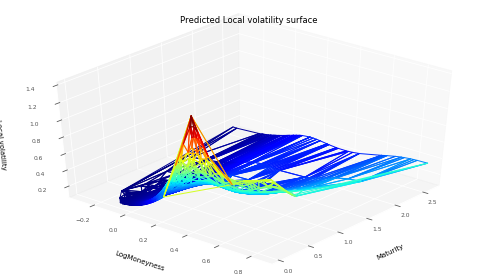

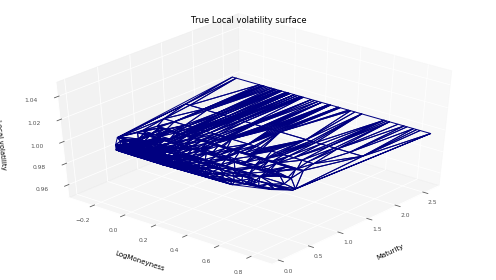

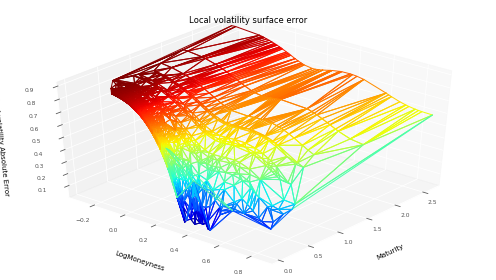

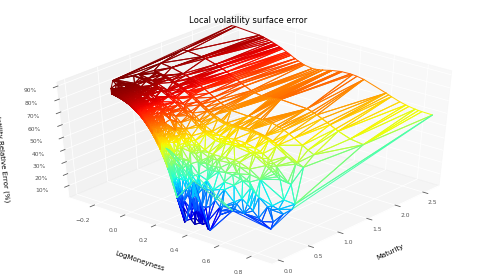

RMSE :  0.7501610614309917
RMSE Relative:  0.7501610614309917


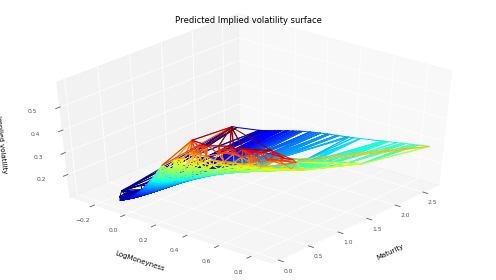

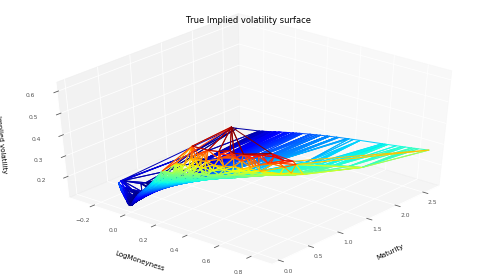

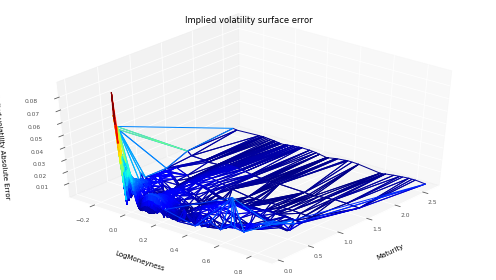

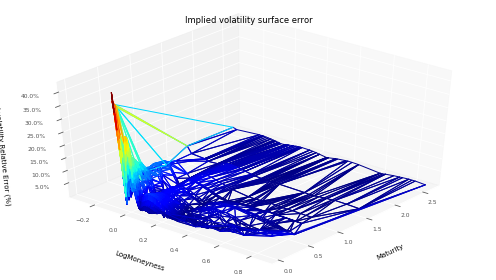

RMSE :  0.012264854215540202
RMSE Relative:  0.08327867545601328


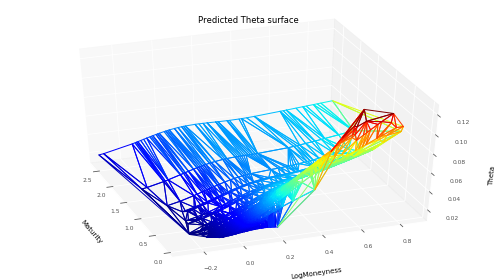

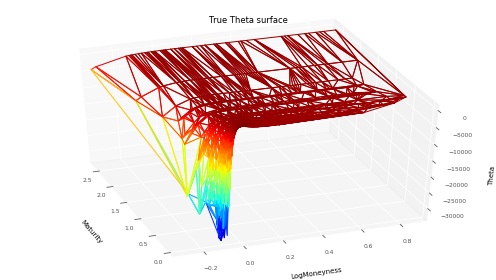

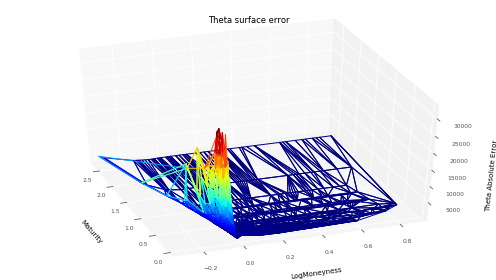

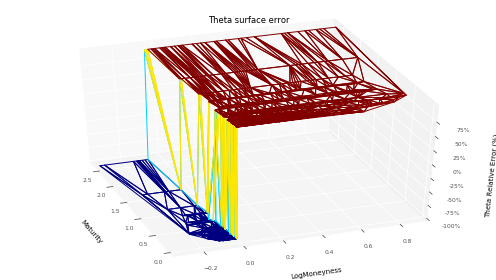

RMSE :  5822.441340828603
RMSE Relative:  0.9992754296971398


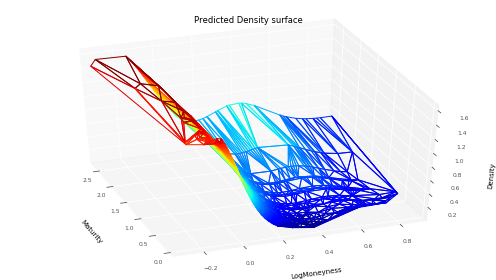

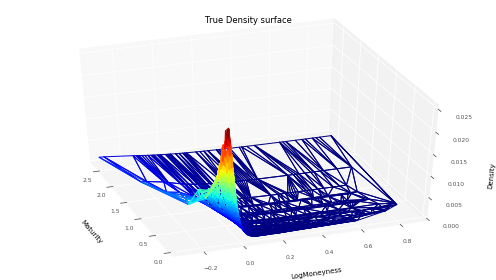

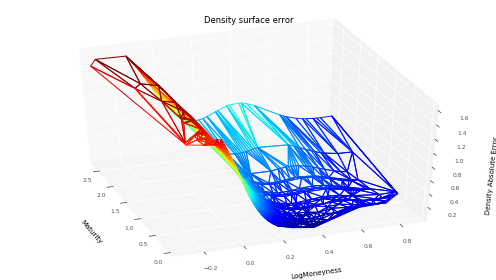

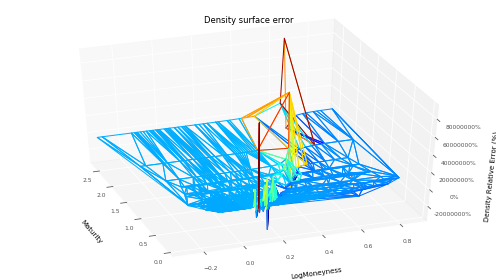

RMSE :  0.8394729572800232
RMSE Relative:  41045.37934372894


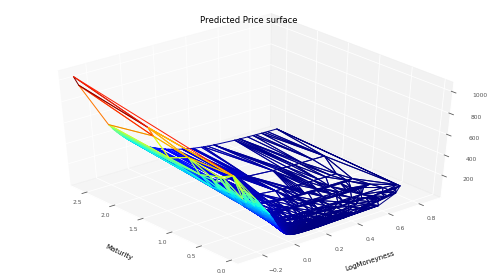

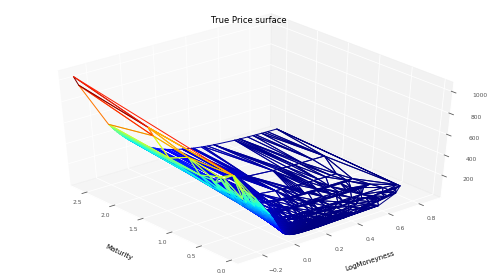

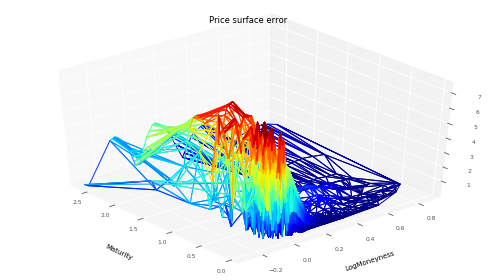

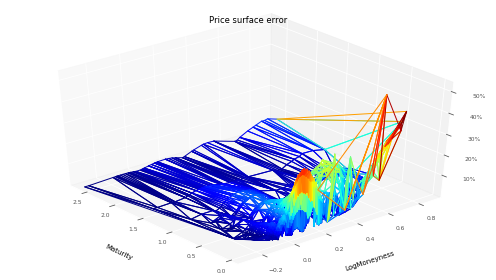

RMSE :  2.8970278269535044
RMSE Relative:  0.10653629664256535
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): -5.21
Best Penalization :  [0.0054314304, 0.0, [0.0, 0.0, 1.767064e-05]]
Best Penalization (Refined Grid):  [[0.0, 0.0, 3.4202567e-05]]
Refined Grid evaluation :
Number of arbitrage violation :  0
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


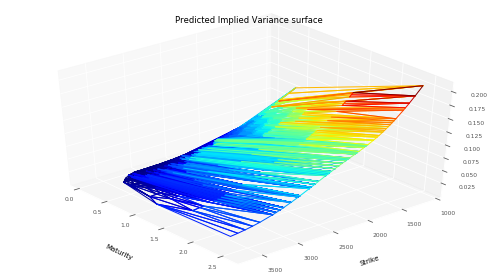

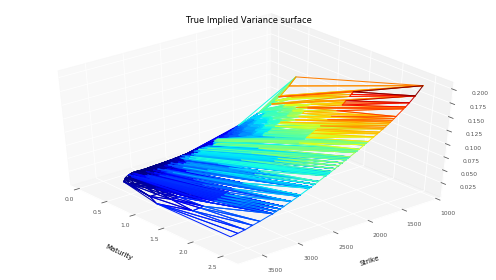

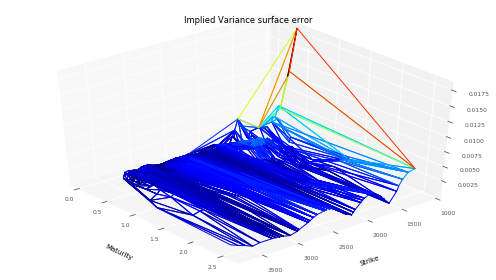

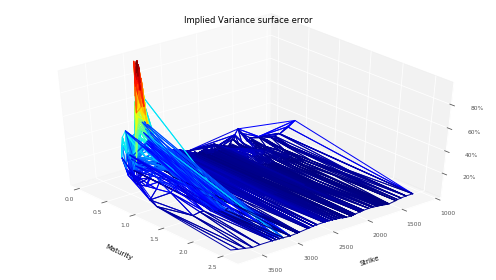

RMSE :  0.0012004852632104435
RMSE Relative:  0.22840535756720248


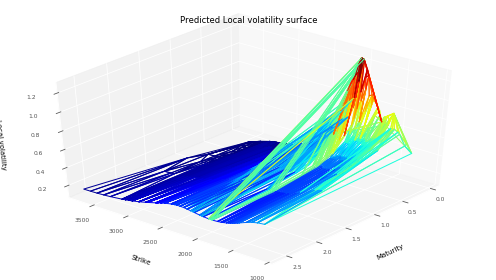

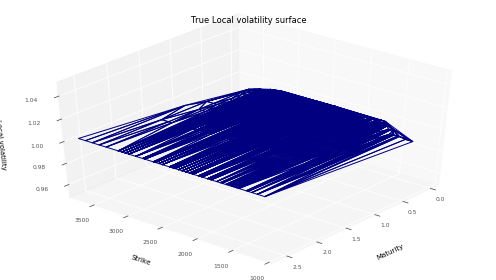

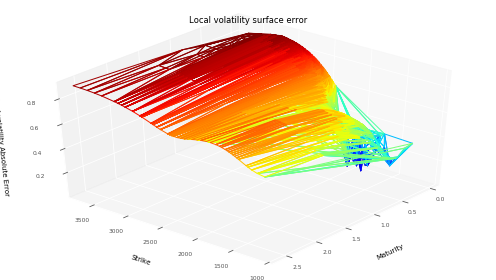

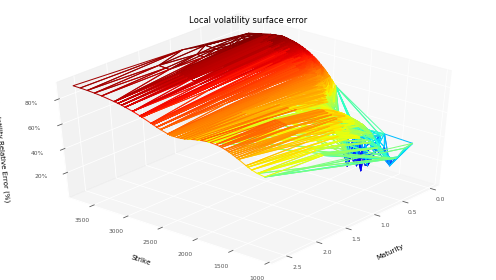

RMSE :  0.74972397317237
RMSE Relative:  0.74972397317237


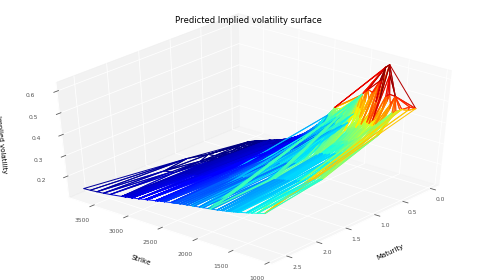

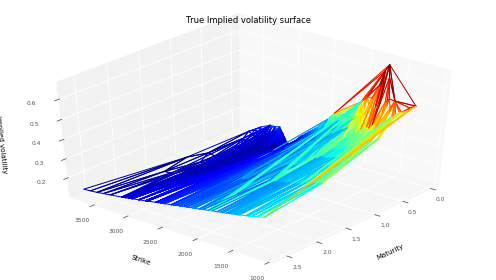

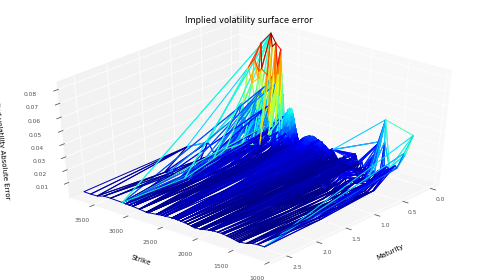

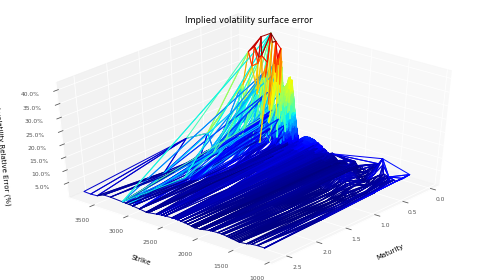

RMSE :  0.012881596866449128
RMSE Relative:  0.08518877360527748


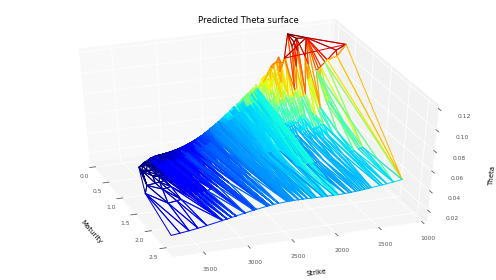

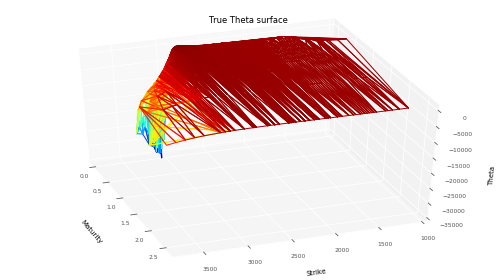

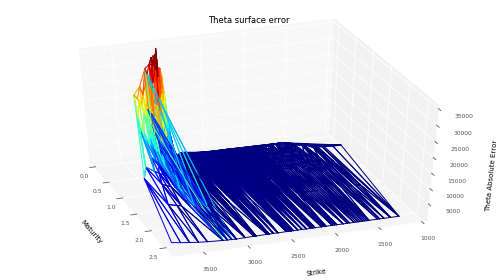

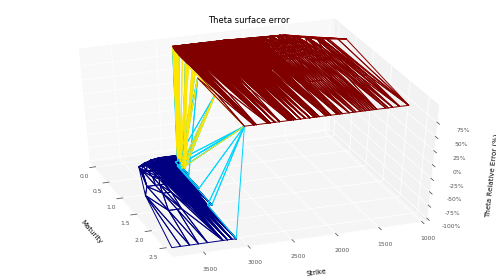

RMSE :  5770.471612355647
RMSE Relative:  0.9992175323571769


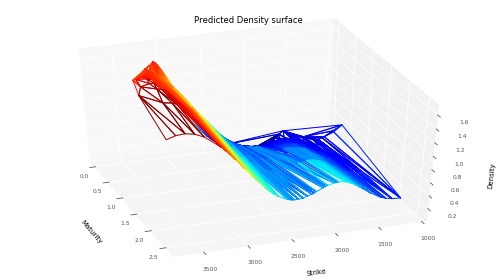

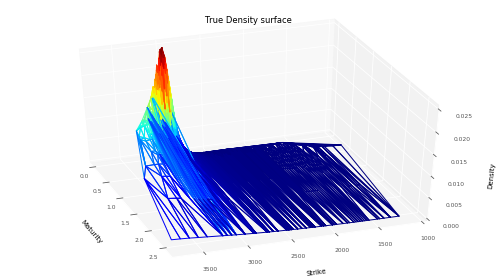

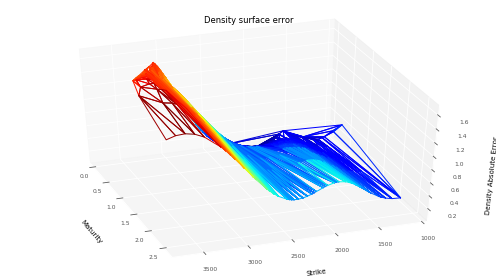

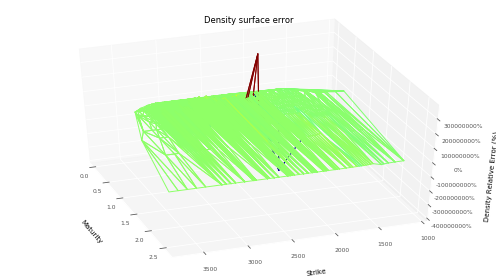

RMSE :  0.8388104448246986
RMSE Relative:  143919.9542722743


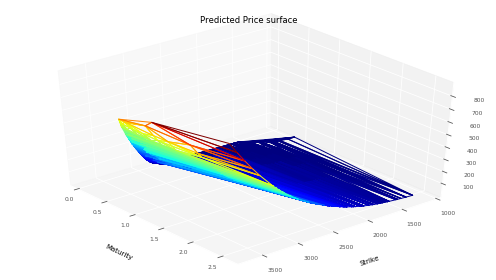

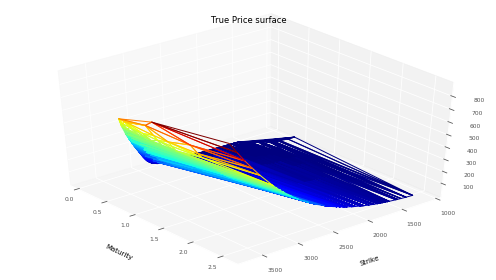

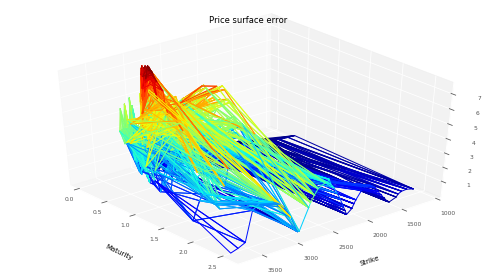

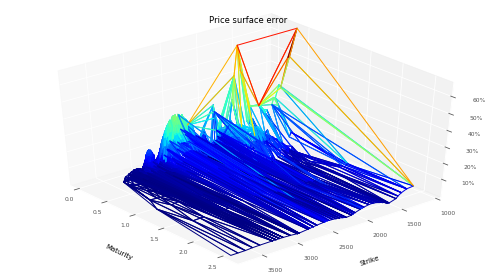

RMSE :  2.966267912316341
RMSE Relative:  0.11271630650601301
------------------------------------------------------------------------------------
Log Moneyness coordinates
------------------------------------------------------------------------------------
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


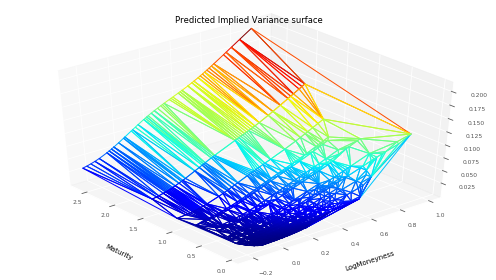

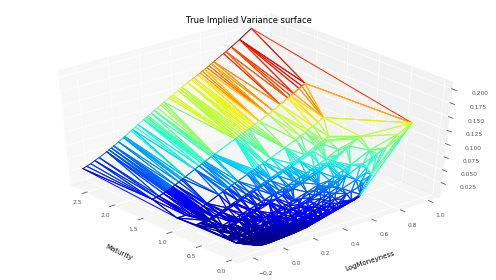

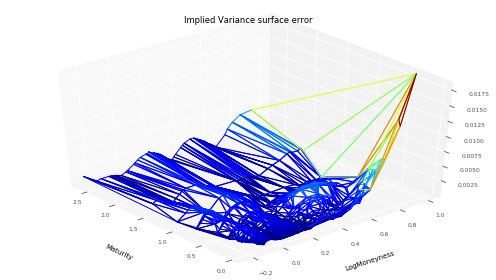

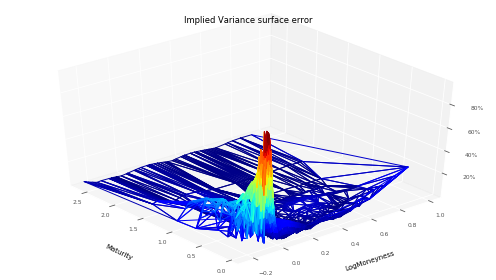

RMSE :  0.0012004852632104435
RMSE Relative:  0.22840535756720248


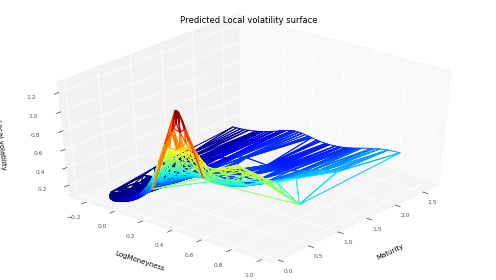

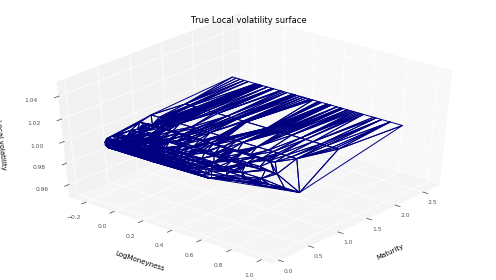

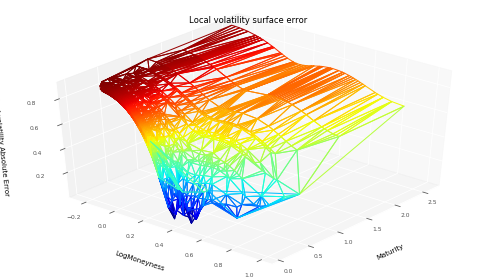

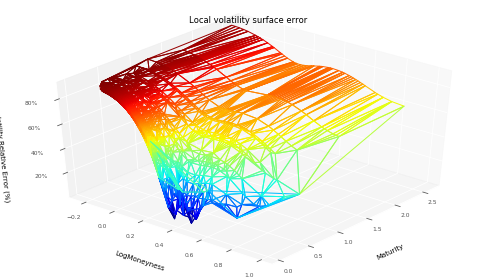

RMSE :  0.74972397317237
RMSE Relative:  0.74972397317237


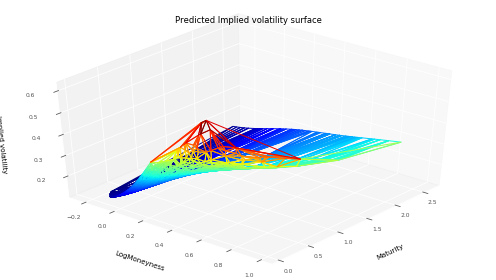

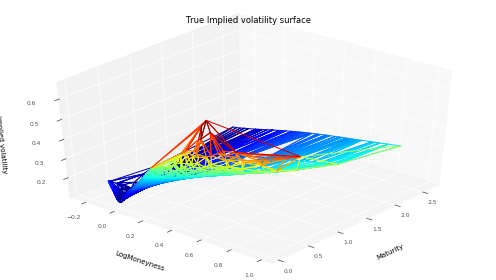

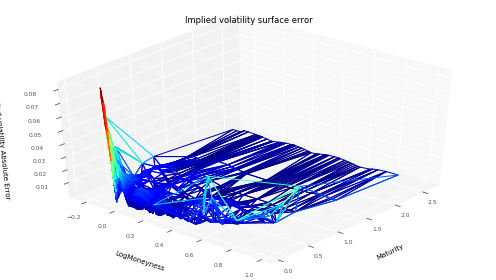

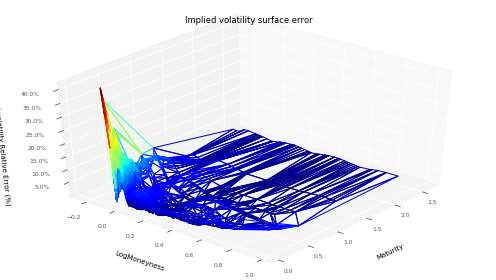

RMSE :  0.012881596866449128
RMSE Relative:  0.08518877360527748


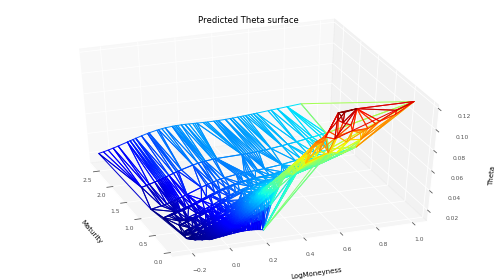

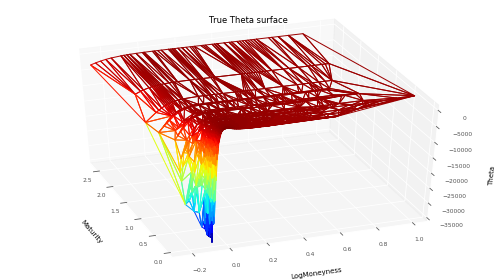

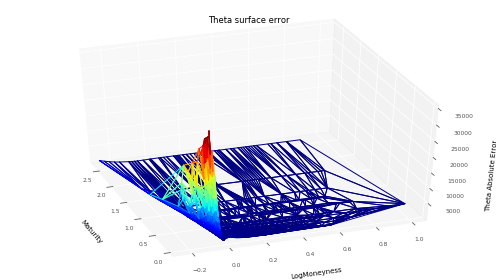

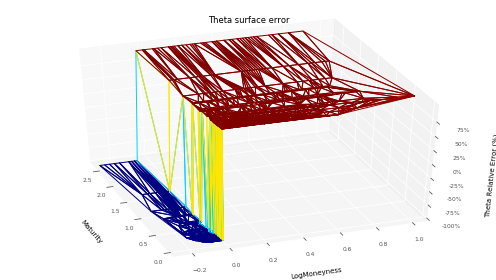

RMSE :  5770.471612355647
RMSE Relative:  0.9992175323571769


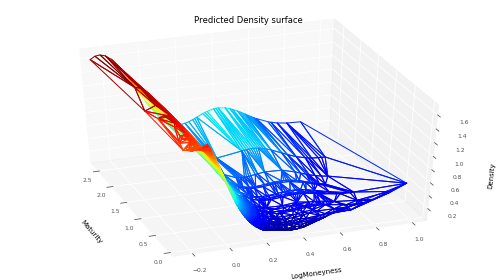

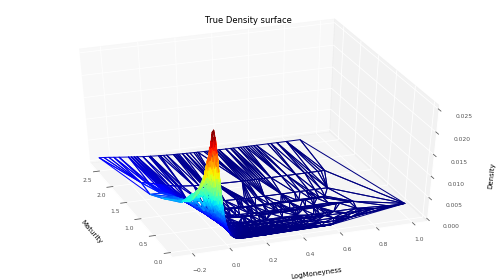

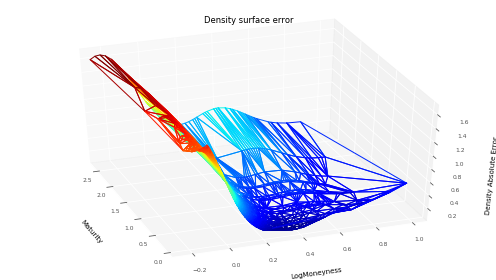

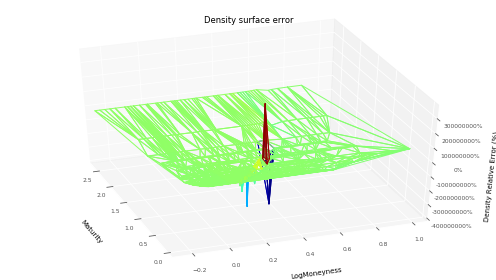

RMSE :  0.8388104448246986
RMSE Relative:  143919.9542722743


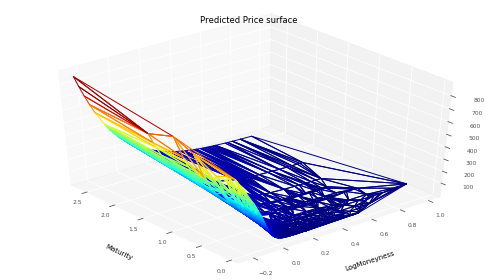

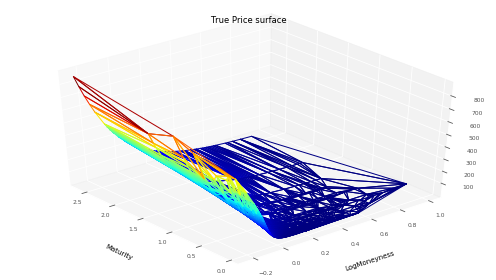

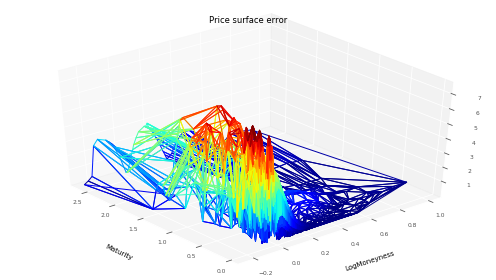

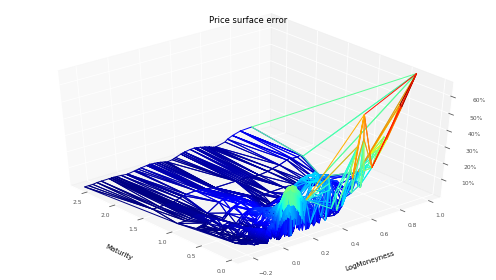

RMSE :  2.966267912316341
RMSE Relative:  0.11271630650601301


In [6]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableFreeImpliedVolatility(dataSet, 
                                                                                     dataSetTest,
                                                                                     hyperparameters,
                                                                                     scaler,
                                                                                     KMin,
                                                                                     KMax,
                                                                                     S0, midS0,
                                                                                     bootstrap)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ d\log{S_t}  = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [7]:
# Function which evaluates neural local volatility when neural network is fitted on implied volatilities
def neuralVolLocaleGatheral(s,t):
    vLoc = neuralNetwork.evalVolLocaleGatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               s, t,
                                               dataSet,
                                               hyperparameters,
                                               scaler,
                                               bootstrap,
                                               S0,
                                               modelName = "convexSoftGatheralVolModel")
    return vLoc.dropna()

In [8]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


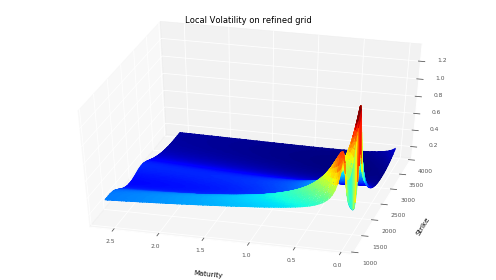

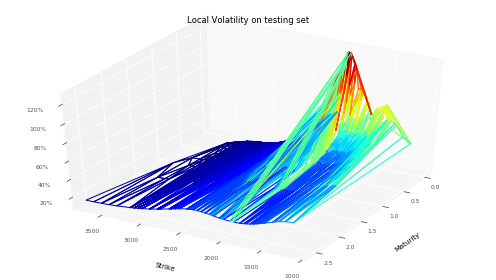

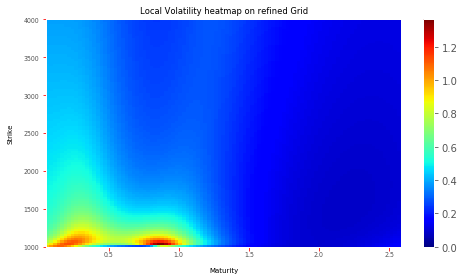

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


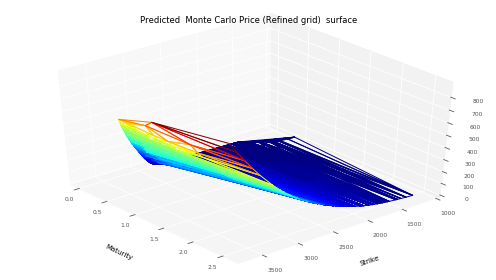

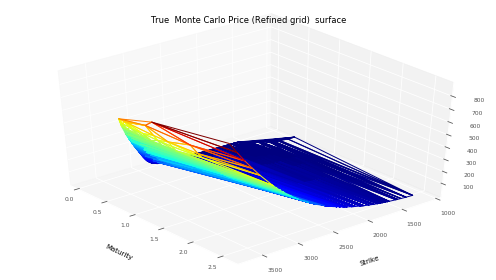

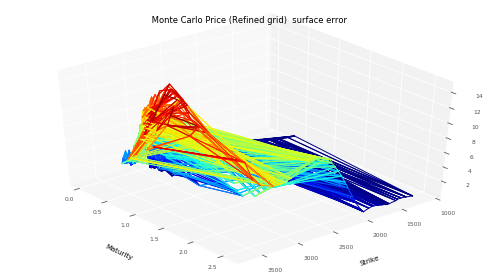

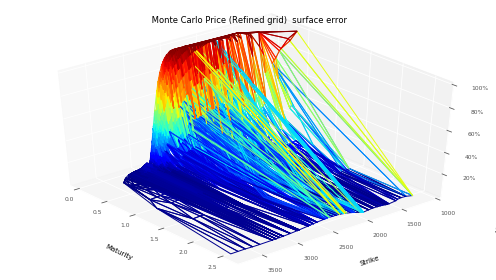

RMSE :  4.988880353279174
RMSE Relative:  0.4504109071083822


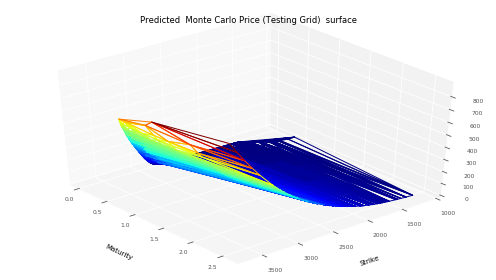

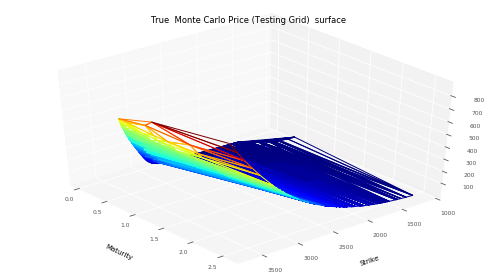

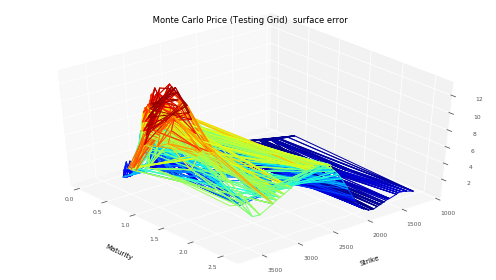

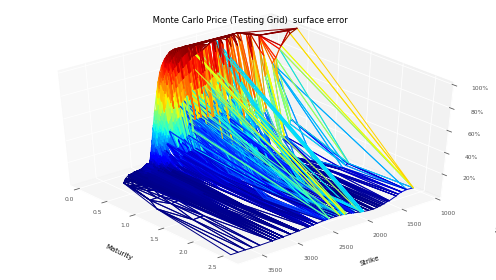

RMSE :  4.550554638056333
RMSE Relative:  0.44010359406996835
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


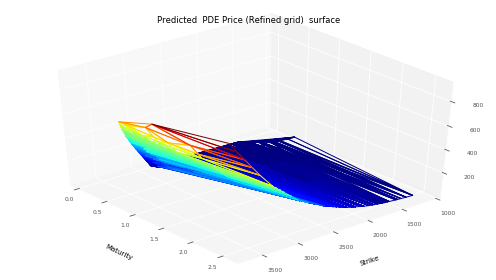

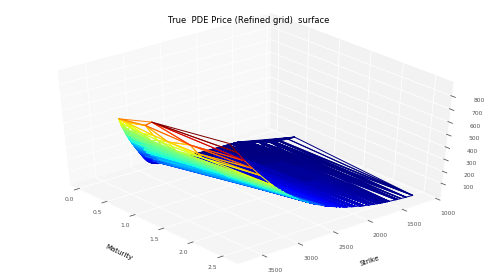

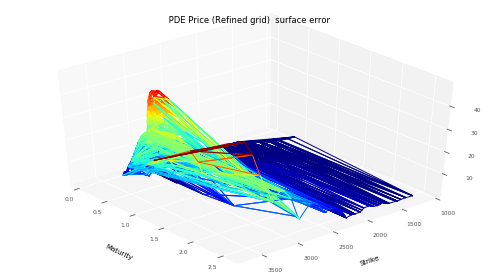

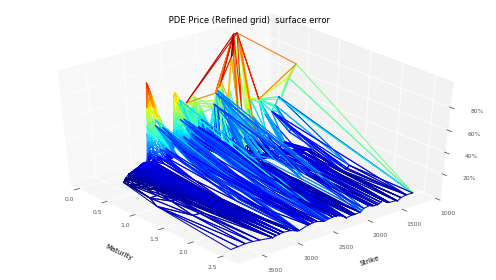

RMSE :  11.97553787342137
RMSE Relative:  0.2828528108165059


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


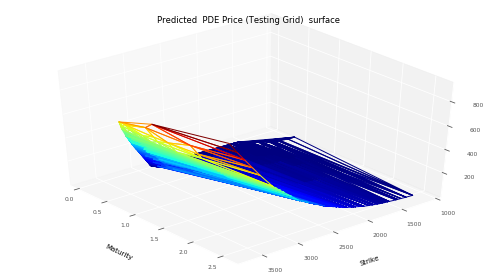

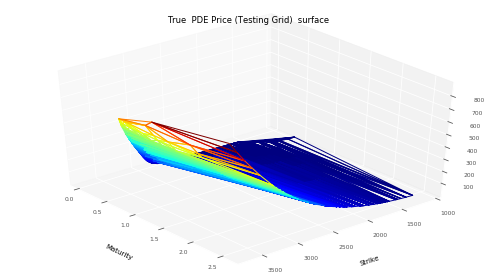

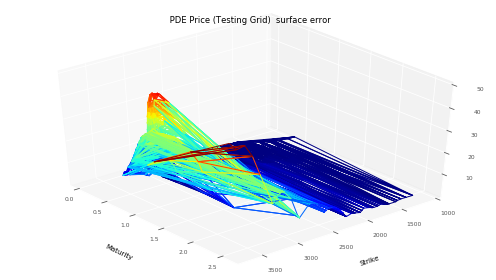

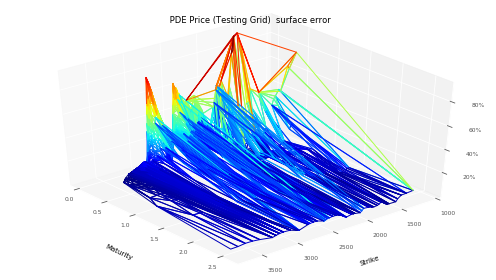

RMSE :  11.825145284786785
RMSE Relative:  0.2852969197315958


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [9]:
resBacktest = experiments.backTestLocalVolatility(neuralVolLocaleGatheral, 
                                                  volLocaleGridDf,
                                                  dataSetTest,
                                                  nbTimeStep,
                                                  nbPaths,
                                                  KMin,
                                                  KMax,
                                                  S0,
                                                  bootstrap,
                                                  "NeuralImpliedVolatility")
volLocalGridRefinedG, volLocalGridTestG, mcResVolLocaleRefinedG, mcResVolLocaleTestG, pdeResVolLocaleRefinedG, pdeResVolLocaleTestG = resBacktest

# Neural network : Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [45]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0.0#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 0.0#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 0.0#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.000001#0.01
hyperparameters["lowerBoundGamma"] = 0.0000001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 1.00

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 10000
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = False
hyperparameters["nbEpochFork"] = 0#10000
hyperparameters["lambdaFork"] = 0.0#1000.0
hyperparameters["HolderExponent"] =  2.0

/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Training w.r.t. price RMSE and arbitrage constraints
Epoch :  6868
False
True
True
False
False
False
True
False
Iteration :  6868 new learning rate :  0.001
Best loss (hidden nodes: 100, iterations: 6869): 0.96
Best Penalization :  [2.6087918, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Epoch :  8758
False
True
True
False
False
False
True
False
Iteration :  8758 new learning rate :  0.0001
Best loss (hidden nodes: 100, iterations: 8759): 0.92
Best Penalization :  [2.49806, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Epoch :  9566
False
True
True
False
False
False
True
False
Iteration :  9566 new learning rate :  1e-05
Best loss (hidden nodes: 100, iterations: 9567): 0.90
Best Penalization :  [2.4564664, 0.0, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Epoch :  9840
False
True
True
False
False
False
True
False
Iteration :  9840 new learning rate :  1.0000000000000002e-06
Best loss (hidden nodes: 1

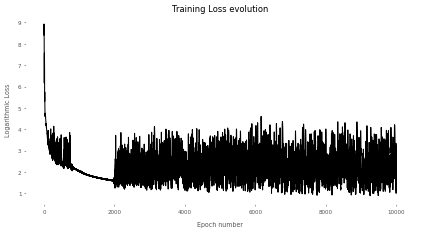

In [15]:
res = experiments.trainNeuralNetworkPrice(dataSet, 
                                          hyperparameters,
                                          scaler, 
                                          False)
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): 2.10
Best Penalization :  [2.4564664, 0.0, [0.16350502, 7.5875523e-06]]
Best Penalization (Refined Grid) :  [[5.7310753, 0.00012446119]]
Refined Grid evaluation :
Number of arbitrage violation :  2138
Dataset Grid evaluation :
Number of arbitrage violation :  31
Number of static arbitrage violations :  31
Arbitrable total variance :  Strike  Maturity
1550.0  0.093          1.533782
3200.0  0.189        339.058411
        0.203        338.588104
        0.246        339.467682
3210.0  0.170        351.204010
        0.246        350.076721
3225.0  0.151        368.565796
        0.246        366

/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


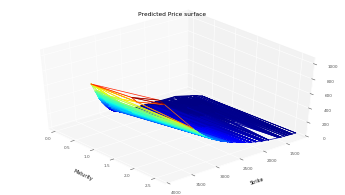

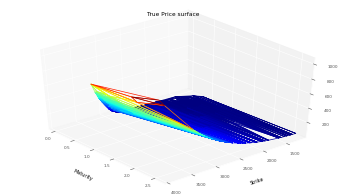

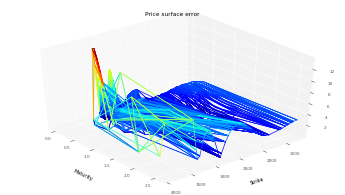

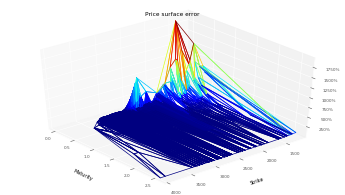

RMSE :  2.45646659810264
RMSE Relative:  1.2856891747021169


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


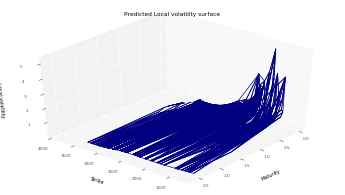

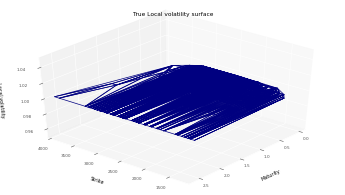

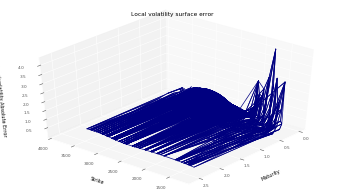

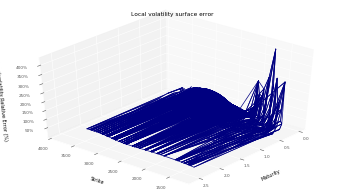

RMSE :  0.7717855703250399
RMSE Relative:  0.7717855703250399


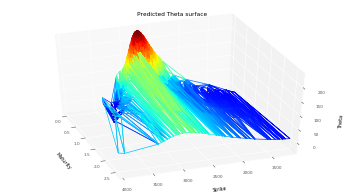

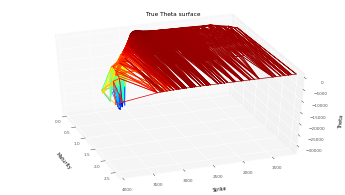

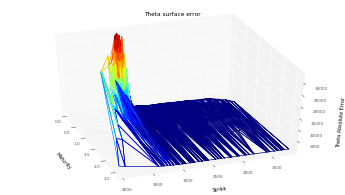

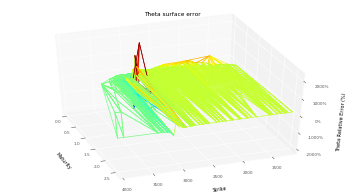

RMSE :  5840.591243380957
RMSE Relative:  1.3546124732682412


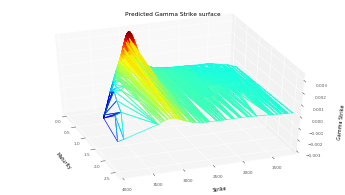

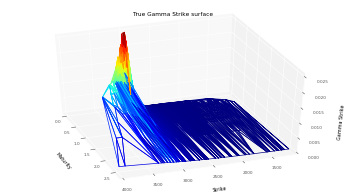

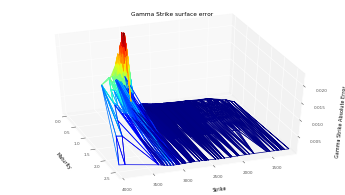

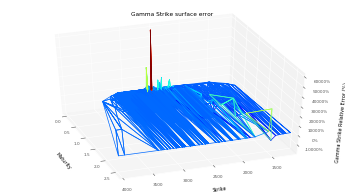

RMSE :  0.005337832457547054
RMSE Relative:  20.900102327074734


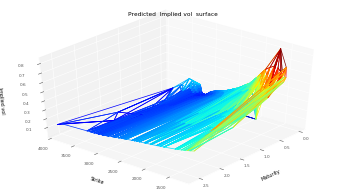

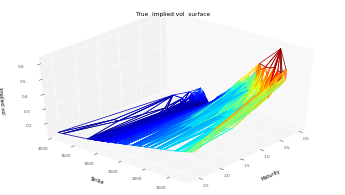

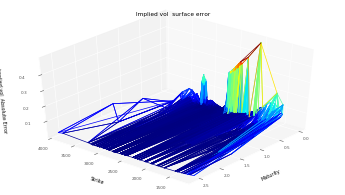

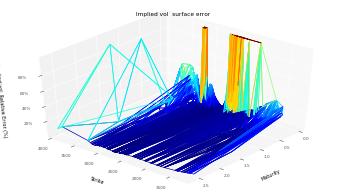

RMSE :  0.05645335284061673
RMSE Relative:  0.21694319711297466
ATM Local Vol :
Strike  Maturity
2860.0  0.055       0.131114
        0.074       0.125567
        0.082       0.124290
        0.093       0.123846
        0.370       0.162040
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Best loss (hidden nodes: 100, iterations: 0): 2.15
Best Penalization :  [2.8875759, 0.0, [0.24146488, 9.344359e-06]]
Best Penalization (Refined Grid) :  [[5.7310753, 0.00012446119]]
Refined Grid evaluation :
Number of arbitrage violation :  2138
Dataset Grid evaluation :
Number of arbitrage violation :  43
Number of static arbitrage violations :  43
Arbitrable total variance

/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


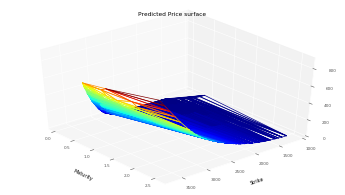

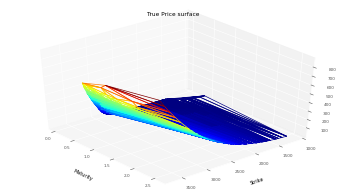

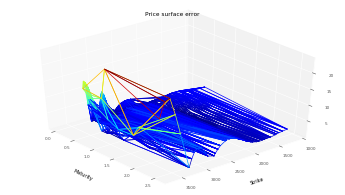

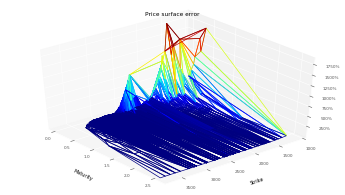

RMSE :  2.88757590376696
RMSE Relative:  1.5333714307639545


/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


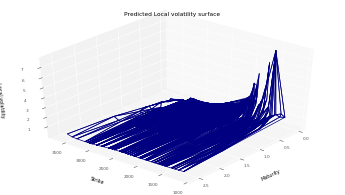

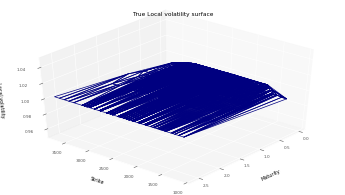

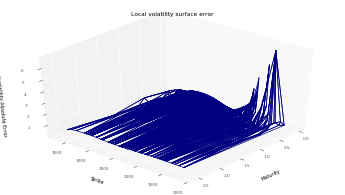

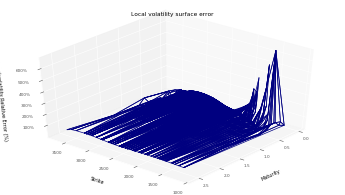

RMSE :  0.7896815853036852
RMSE Relative:  0.7896815853036852


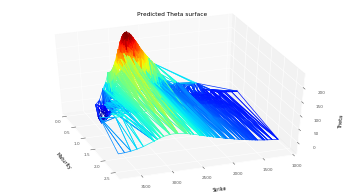

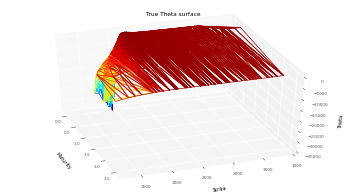

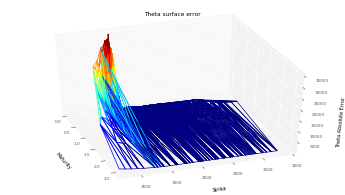

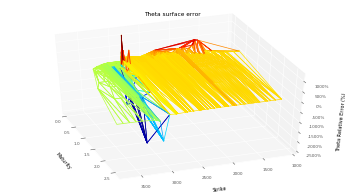

RMSE :  5788.743554949046
RMSE Relative:  1.3871702848044056


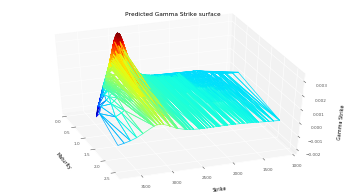

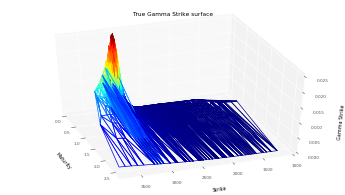

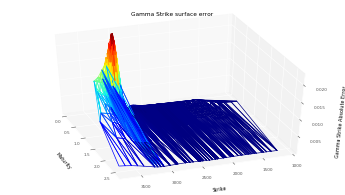

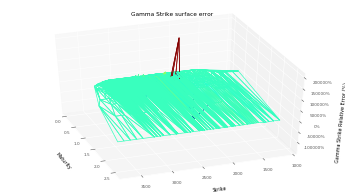

RMSE :  0.005043231804834986
RMSE Relative:  70.21730614227472


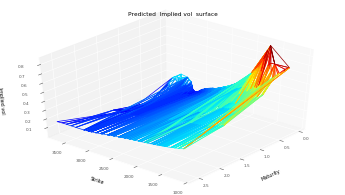

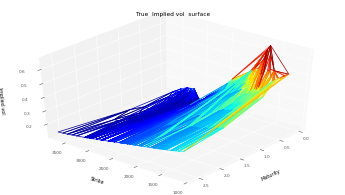

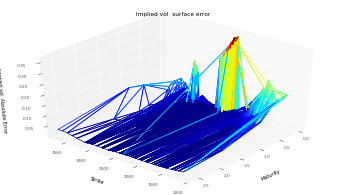

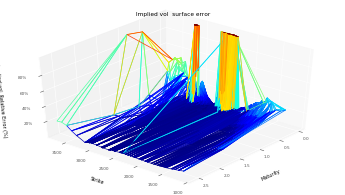

RMSE :  0.06144854860012503
RMSE Relative:  0.23531360096280324


In [47]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrablePrice(dataSet, 
                                                                     dataSetTest,
                                                                     hyperparameters,
                                                                     scaler,
                                                                     KMin,
                                                                     KMax,
                                                                     S0, midS0,
                                                                     bootstrap)

#### with arbitrage constraints.

In [17]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 5.0 * 1e0#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1e4#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 1e7#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.000001#0.01
hyperparameters["lowerBoundGamma"] = 0.0000001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10.0
hyperparameters["DupireVolLowerBound"] = 0.03
hyperparameters["DupireVolUpperBound"] = 1.00

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.01
hyperparameters["Patience"] = 10000
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

hyperparameters["UseLogMaturity"] = False
hyperparameters["nbEpochFork"] = 0#10000
hyperparameters["lambdaFork"] = 0.0#1000.0
hyperparameters["HolderExponent"] =  2.0

/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Training w.r.t. price RMSE and arbitrage constraints
Training w.r.t. price RMSE, arbitrage constraints and bid-ask fork violation
Best loss (hidden nodes: 100, iterations: 10000): 2.29
Best Penalization :  [9.851394, 0.0, [0.0, 0.0, 0.39708462]]
Best Penalization (Refined Grid) :  [[0.0, 0.0014854723, 0.02472905]]
Refined Grid evaluation :
Number of arbitrage violation :  1
Dataset Grid evaluation :
Training Time :  185.4359200000763
Number of arbitrage violation :  0


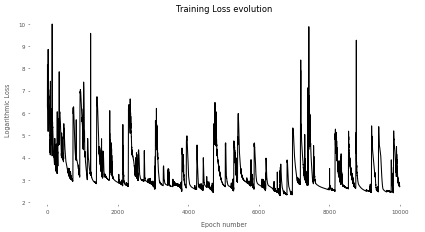

In [19]:
res = experiments.trainNeuralNetworkPrice(dataSet, 
                                          hyperparameters,
                                          scaler, 
                                          True)
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Training Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): 2.29
Best Penalization :  [9.851394, 0.0, [0.0, 0.0, 0.39708462]]
Best Penalization (Refined Grid) :  [[0.0, 0.0014854723, 0.02472905]]
Refined Grid evaluation :
Number of arbitrage violation :  1
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


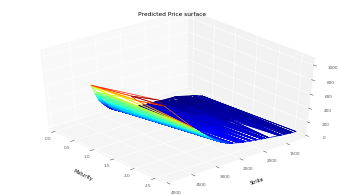

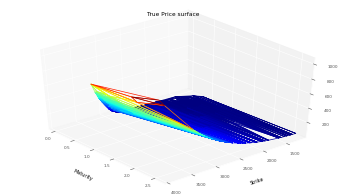

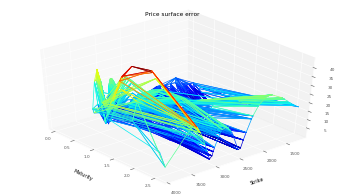

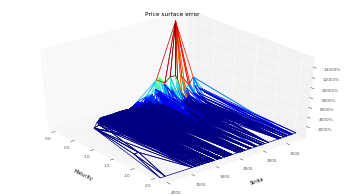

RMSE :  9.85139366211326
RMSE Relative:  6.168067202944499


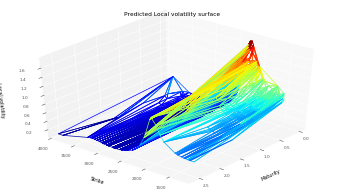

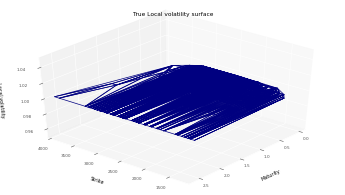

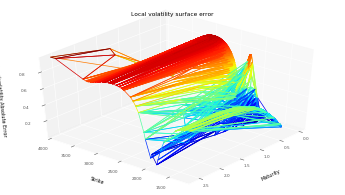

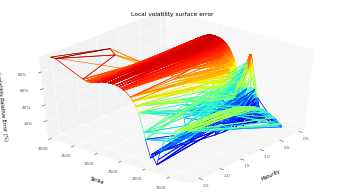

RMSE :  0.7224693544905766
RMSE Relative:  0.7224693544905766


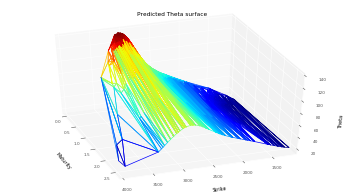

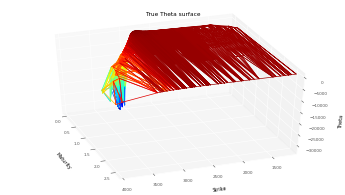

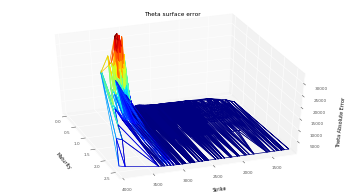

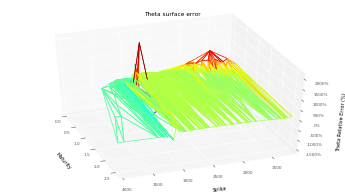

RMSE :  5866.683098667945
RMSE Relative:  1.2982471718821769


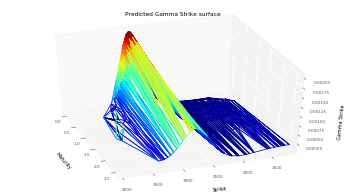

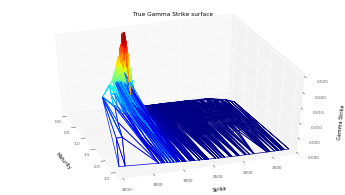

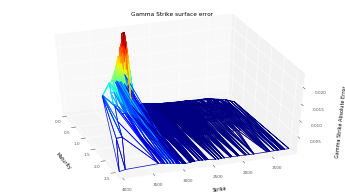

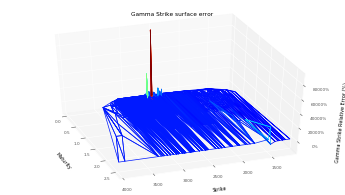

RMSE :  0.00558616313576991
RMSE Relative:  26.313336303988397


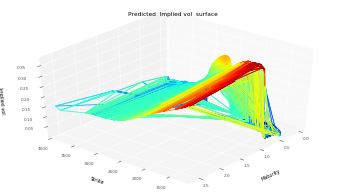

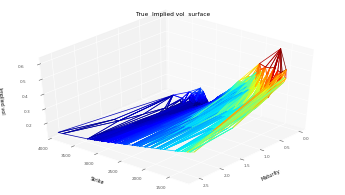

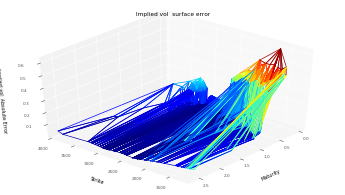

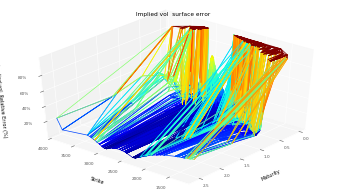

RMSE :  0.13699538324063193
RMSE Relative:  0.46836746513998095
ATM Local Vol :
Strike  Maturity
2860.0  0.055       0.121138
        0.074       0.120953
        0.082       0.120881
        0.093       0.120836
        0.370       0.119677
Name: Dupire, dtype: float32
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Testing Set
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


/home/chataigner/anaconda3/lib/python3.7/site-packages/tensorflow/python/ops/gradients_impl.py:110: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Best loss (hidden nodes: 100, iterations: 0): 2.34
Best Penalization :  [10.346874, 0.0, [0.0, 0.0, 0.3703568]]
Best Penalization (Refined Grid) :  [[0.0, 0.0014854723, 0.02472905]]
Refined Grid evaluation :
Number of arbitrage violation :  1
Dataset Grid evaluation :
Number of arbitrage violation :  0
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/home/chataigner/anaconda3/lib/python3.7/site-packages/pandas/core/computation/expressions.py:183: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


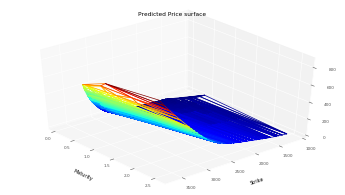

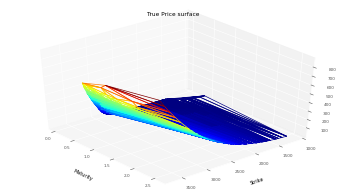

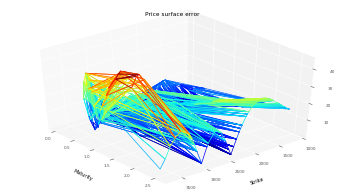

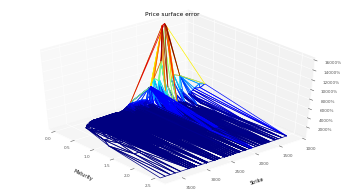

RMSE :  10.346874592793247
RMSE Relative:  9.045024428624753


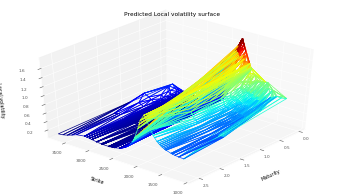

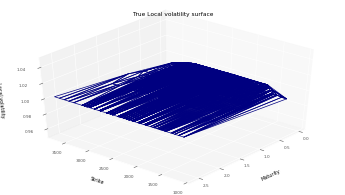

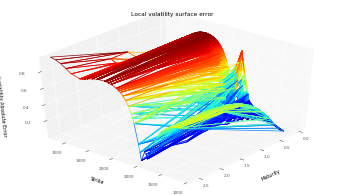

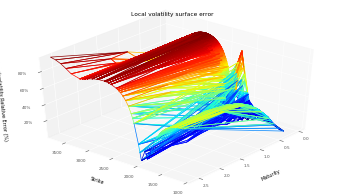

RMSE :  0.7199905054865035
RMSE Relative:  0.7199905054865035


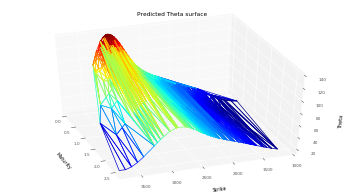

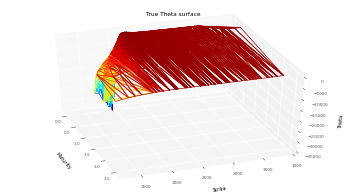

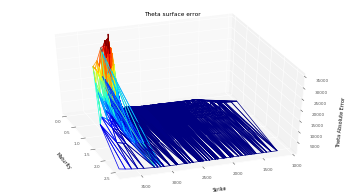

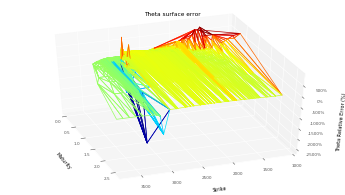

RMSE :  5810.689388534417
RMSE Relative:  1.3859899117091932


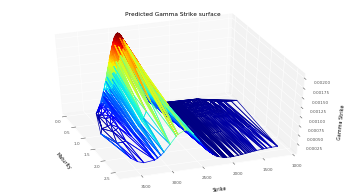

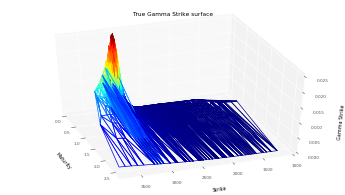

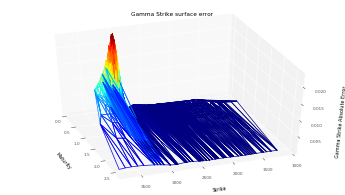

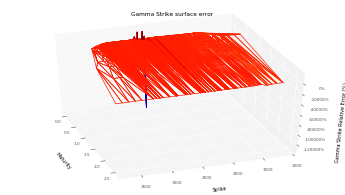

RMSE :  0.005291030305961757
RMSE Relative:  41.07119652487635


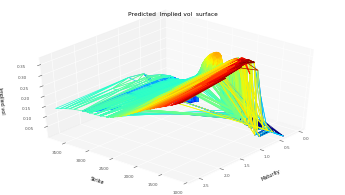

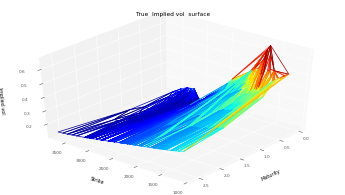

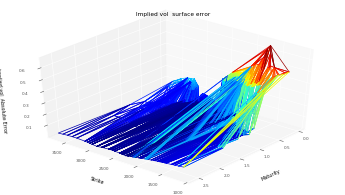

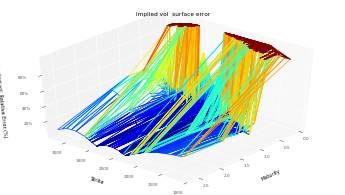

RMSE :  0.142725156878924
RMSE Relative:  0.4697598385436485


In [20]:
resTrain, resTest = experiments.evaluateNeuralNetworkArbitrableFreePrice(dataSet, 
                                                                         dataSetTest,
                                                                         hyperparameters,
                                                                         scaler,
                                                                         KMin,
                                                                         KMax,
                                                                         S0, midS0,
                                                                         bootstrap)

#### Monte Carlo and PDE repricing backtests
 


In [21]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "convexSoftVolModel")
    return vLoc.dropna()

In [22]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


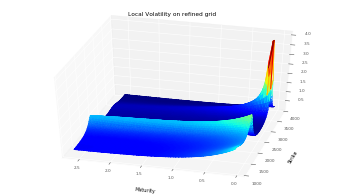

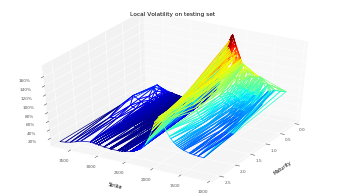

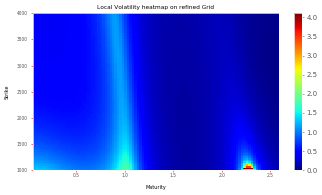

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


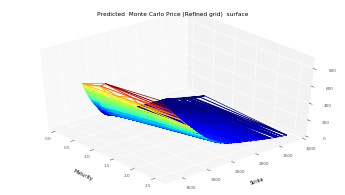

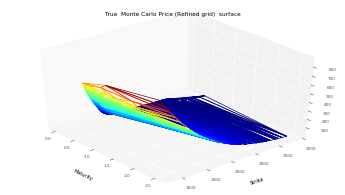

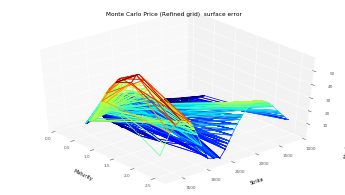

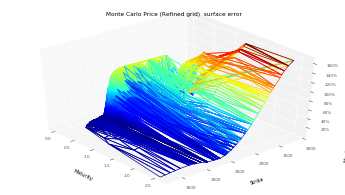

RMSE :  11.764209307317959
RMSE Relative:  0.5692353365447387


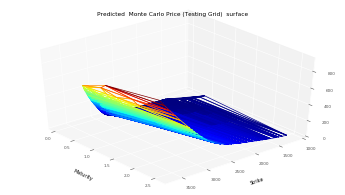

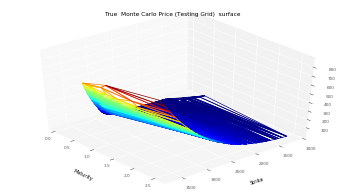

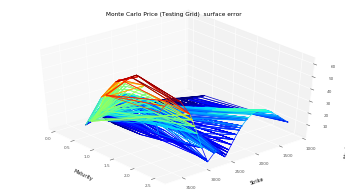

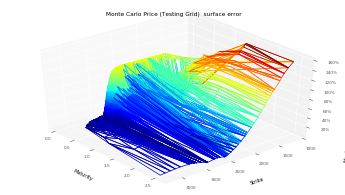

RMSE :  12.304920167973515
RMSE Relative:  0.5863710893008891
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


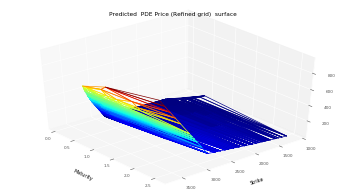

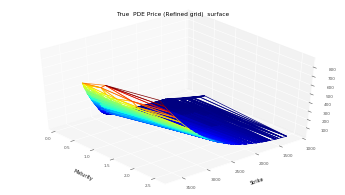

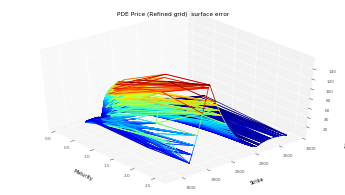

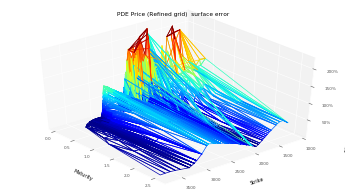

RMSE :  26.784816163928614
RMSE Relative:  0.6137582044952898


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


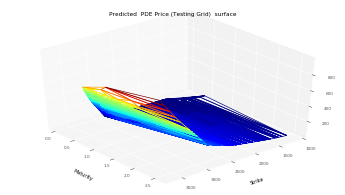

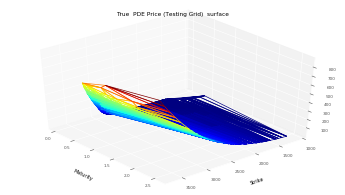

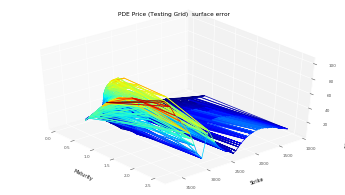

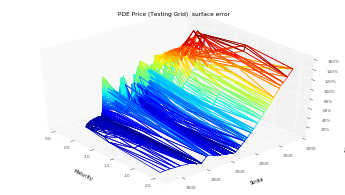

RMSE :  19.583187154685696
RMSE Relative:  0.507234424366686


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [23]:
resBacktest = experiments.backTestLocalVolatility(neuralVolLocalePrix, 
                                                  volLocaleGridDf,
                                                  dataSetTest,
                                                  nbTimeStep,
                                                  nbPaths,
                                                  KMin,
                                                  KMax,
                                                  S0,
                                                  bootstrap,
                                                  "NeuralPrice")
volLocalGridRefined, volLocalGridTest, mcResVolLocaleRefined, mcResVolLocaleTest, pdeResVolLocaleRefined, pdeResVolLocaleTest = resBacktest

## SSVI Unconstrained

#### Run SSVI Model

Implementation is inspired from Tahar Ferhati code : 
- Ferhati, T. (2020). Robust Calibration For SVI Model Arbitrage Free. Available at SSRN 3543766.

Black crosses in local volatility plots locate arbitrage violations thanks to finite difference sensitivities. 

In [24]:
ssviModel = experiments.trainSSVIModel(dataSet, S0, bootstrap, False)

time step 0  :  0.055
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.0011353323543186978
            Iterations: 52
            Function evaluations: 381
            Gradient evaluations: 52
time step 1  :  0.063
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.00028893490058177774
            Iterations: 19
            Function evaluations: 144
            Gradient evaluations: 19
time step 2  :  0.068
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.0009360564495116522
            Iterations: 24
            Function evaluations: 177
            Gradient evaluations: 24
time step 3  :  0.07400000000000001
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.003718999018018487
            Iterations: 30
            Function evaluations: 223
            Gradient evaluations: 30
time step 4  :  0.08199999999999999
Op

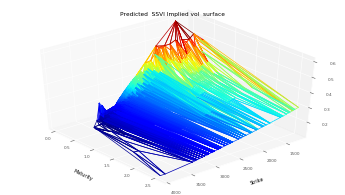

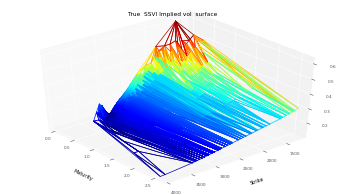

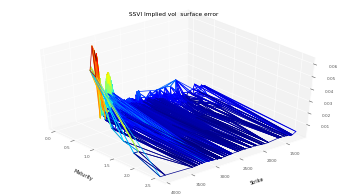

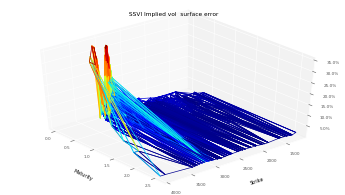

RMSE :  0.010368485802803713
RMSE Relative:  0.07593042977499055


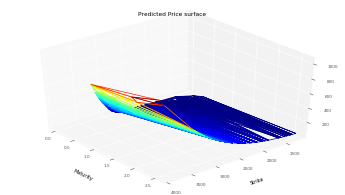

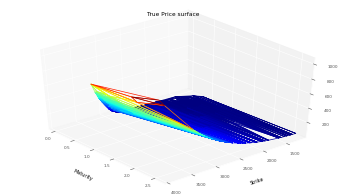

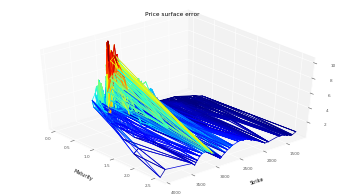

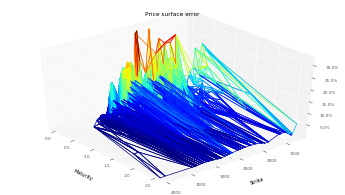

RMSE :  2.6907984735570842
RMSE Relative:  0.08026526393687176


./code/SSVIFerhati.py:746: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


Number of arbitrage violations :  175
Arbitrable volatility :  Strike  Maturity
1325.0  0.621       0.392601
1350.0  0.621       0.386511
1400.0  0.841       0.343174
1425.0  0.621       0.369398
        0.841       0.339092
1450.0  0.621       0.364428
1475.0  0.841       0.330356
1500.0  0.621       0.353988
1525.0  0.621       0.349126
1575.0  0.621       0.339872
        0.841       0.315210
1650.0  0.621       0.325103
        0.841       0.302510
1675.0  0.841       0.300679
1700.0  0.131       0.494278
        0.841       0.297572
1725.0  0.841       0.294571
1750.0  0.621       0.308134
1775.0  0.621       0.304199
        0.841       0.287759
1800.0  0.621       0.300013
        0.841       0.284331
1825.0  0.841       0.281265
1875.0  0.621       0.288326
1900.0  0.131       0.425823
        0.621       0.284459
1975.0  0.621       0.273649
        0.841       0.262794
2000.0  0.131       0.391238
        0.621       0.269981
                      ...   
3035.0  0.131       0

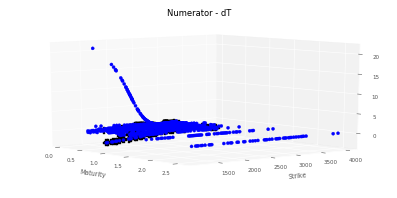

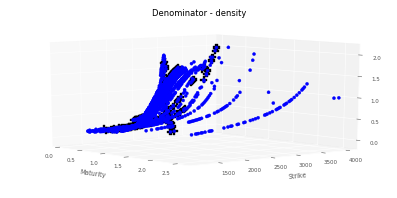

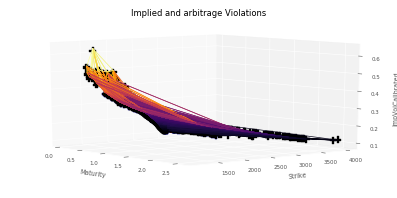

/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


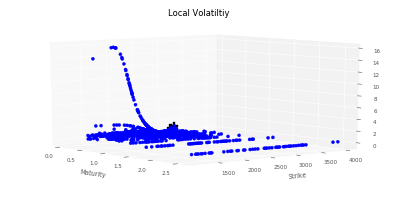

In [25]:
serie, dT, hk, dK, locVolSSVI, density = experiments.evalSSVIModel(dataSet, 
                                                                   ssviModel, 
                                                                   KMin, KMax, 
                                                                   S0,
                                                                   bootstrap, 
                                                                   "SSVIUnconstrainedTraining")


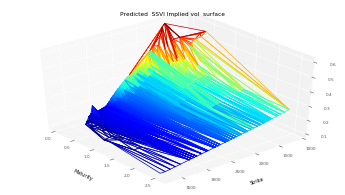

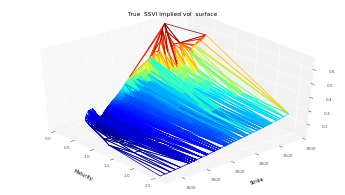

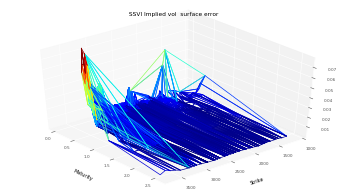

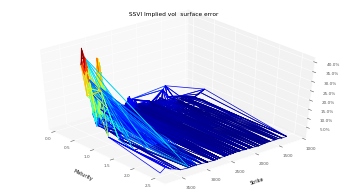

RMSE :  0.010901053769759963
RMSE Relative:  0.07673713873231379


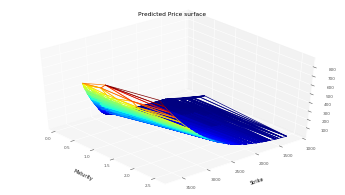

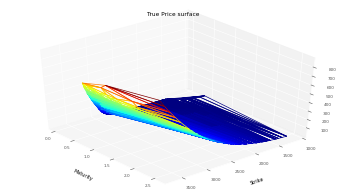

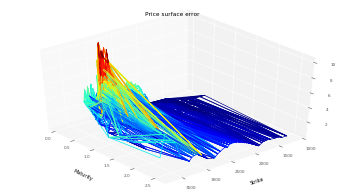

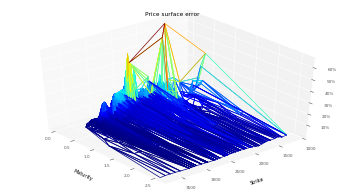

RMSE :  2.7906087672005224
RMSE Relative:  0.09068172570172658


./code/SSVIFerhati.py:746: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


Number of arbitrage violations :  177
Arbitrable volatility :  Strike  Maturity
1275.0  0.621       0.404517
1300.0  0.621       0.398610
1375.0  0.621       0.380357
1400.0  0.621       0.374944
1450.0  0.841       0.334808
1475.0  0.621       0.358645
1500.0  0.841       0.326848
1525.0  0.841       0.322745
1550.0  0.621       0.344093
        0.841       0.319092
1600.0  0.621       0.334517
        0.841       0.311134
1625.0  0.621       0.329902
        0.841       0.307906
1675.0  0.621       0.320874
1700.0  0.621       0.316420
1725.0  0.621       0.311772
1750.0  0.131       0.478358
        0.841       0.290933
1800.0  0.131       0.460873
1825.0  0.621       0.296080
1850.0  0.131       0.442365
        0.621       0.291900
        0.841       0.278208
1875.0  0.841       0.275145
1900.0  0.841       0.271822
1925.0  0.621       0.281051
        0.841       0.268723
1950.0  0.131       0.408037
        0.621       0.277331
                      ...   
3050.0  0.063       0

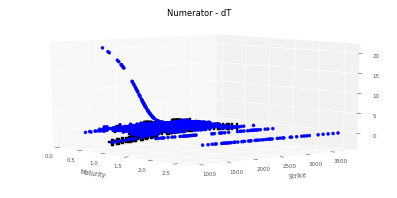

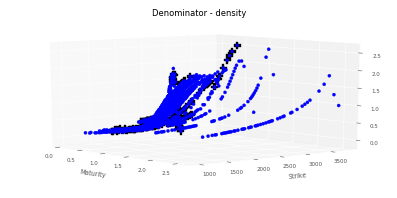

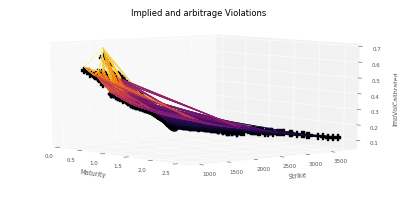

/home/chataigner/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:512: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


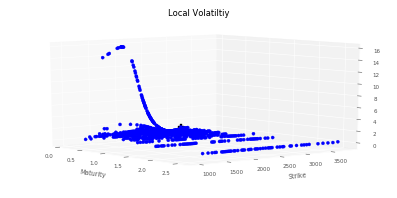

In [26]:
serieTest, dTTest, hkTest, dKTest, locVolSSVITest, densityTest = experiments.evalSSVIModel(dataSetTest, 
                                                                                           ssviModel, 
                                                                                           KMin, KMax, 
                                                                                           S0,
                                                                                           bootstrap, 
                                                                                           "SSVIUnconstrainedTesting")

## SSVI Constrained

#### Run SSVI Model

Implementation is inspired from Matlab code of Philipp Rindler : 
- Philipp Rindler (2020). Gatherals and Jacquier's Arbitrage-Free SVI Volatility Surfaces (https://www.mathworks.com/matlabcentral/fileexchange/49962-gatherals-and-jacquier-s-arbitrage-free-svi-volatility-surfaces), MATLAB Central File Exchange. Retrieved November 20, 2020.

In [16]:
ssviModel = experiments.trainSSVIModel(dataSet, S0, bootstrap, True)

Contrainte :  -0.4273877355014666
Parameters of SSVI model :  [-0.53616616  1.02372536  0.5       ]
time step 25  :  2.585

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.22919688748989853    satisfied
RMSE :  0.09625156480907125



./code/SSVI.py:680: RuntimeWarning: invalid value encountered in sqrt
  alpha = np.sign(beta) * np.sqrt(1 / beta ** 2 - 1)
./code/SSVI.py:682: RuntimeWarning: invalid value encountered in sqrt
  (b * (-rho + np.sign(alpha) * np.sqrt(1 + alpha ** 2) - alpha * np.sqrt(1 - rho ** 2))))
./code/SSVI.py:693: RuntimeWarning: invalid value encountered in sqrt
  a = vt * tau - b * sigma * np.sqrt(1 - rho ** 2)
./code/SSVI.py:311: RuntimeWarning: invalid value encountered in less
  if any(model_total_implied_variance < before_total_implied_variance) :


Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.14643615312943542    satisfied
RMSE :  0.02457001032359658
--------------------------------------------------------------------

time step 24  :  1.588

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.23276982374380406    satisfied
RMSE :  0.030748011344840433



./code/SSVI.py:316: RuntimeWarning: invalid value encountered in greater
  if any(model_total_implied_variance > after_total_implied_variance) :


Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.17427781105654216    satisfied
RMSE :  0.01581690870780164
--------------------------------------------------------------------

time step 23  :  1.09

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.23441434506996173    satisfied
RMSE :  0.013098043426726871

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.19787259912666033    satisfied
RMSE :  0.008422603975483998
--------------------------------------------------------------------

time step 22  :  0.871

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.23510187233706048    satisfied
RMSE :  0.017310969555639988

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.22128964972465615    satisfied
RMSE :  0.011258934737743278
--------------------------------------------------------------------

time step 21  :  0.841

x0
Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.2351924310998

Calendar constraint :  0.0    satisfied
Butterfly constraint :  0.26585909042983935    satisfied
RMSE :  0.0019338993099869387
--------------------------------------------------------------------

Training Time :  30.056639432907104


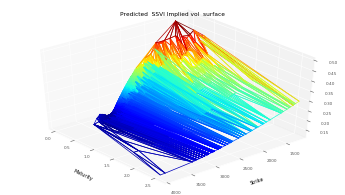

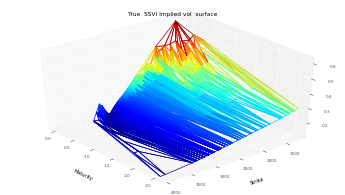

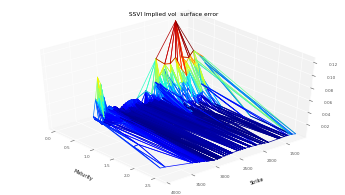

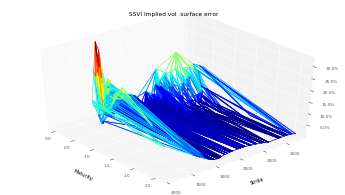

RMSE :  0.01368587035979151
RMSE Relative:  0.06547129856256104


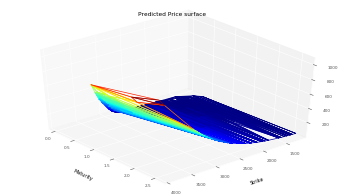

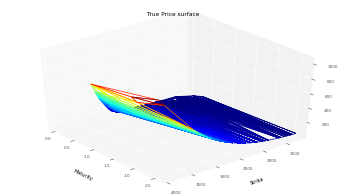

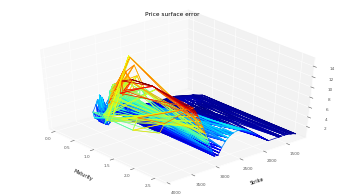

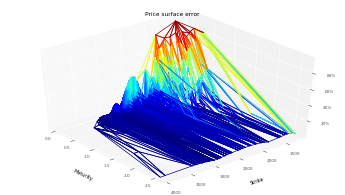

RMSE :  2.5732216592995893
RMSE Relative:  0.17007566081740078
Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpVolCalibrated, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


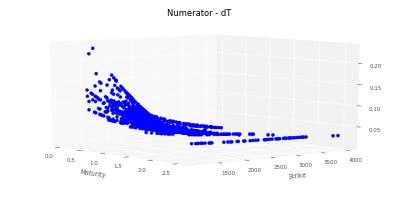

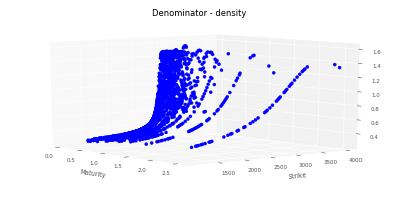

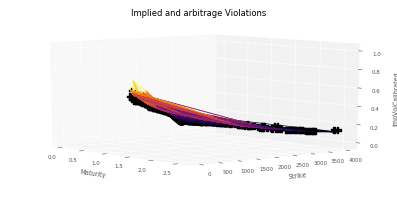

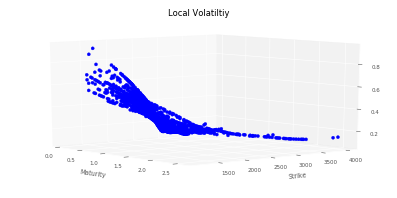

In [17]:
serie, dT, hk, dK, locVolSSVI, density = experiments.evalSSVIModel(dataSet, 
                                                                   ssviModel, 
                                                                   KMin, KMax, 
                                                                   S0,
                                                                   bootstrap, 
                                                                   "SSVIConstrainedTraining")

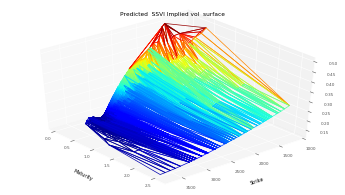

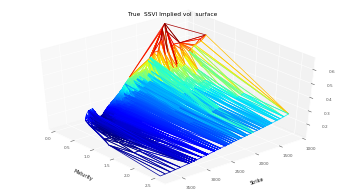

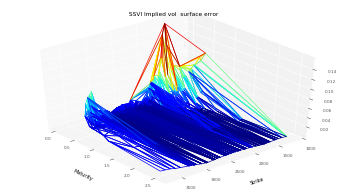

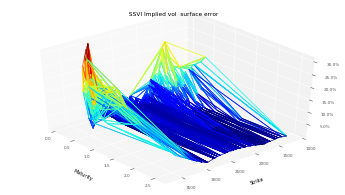

RMSE :  0.015238029509396848
RMSE Relative:  0.06889789782110133


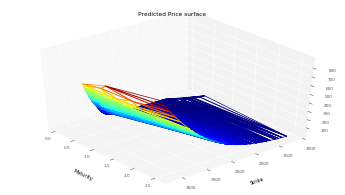

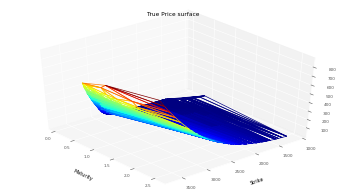

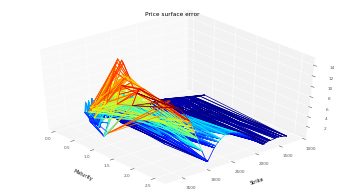

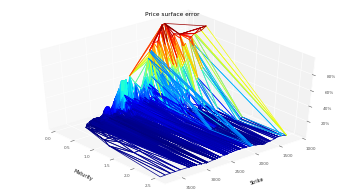

RMSE :  2.8911641254220704
RMSE Relative:  0.17810627257094608
Number of arbitrage violations :  0
Arbitrable volatility :  Series([], Name: ImpVolCalibrated, dtype: float64)
Interpolated Arbitrable volatility :  Series([], dtype: float64)


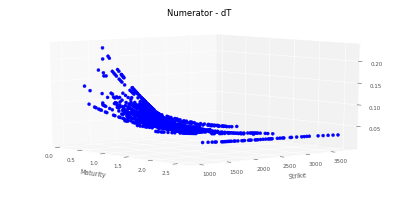

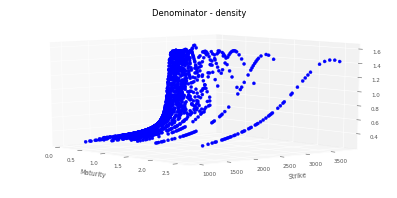

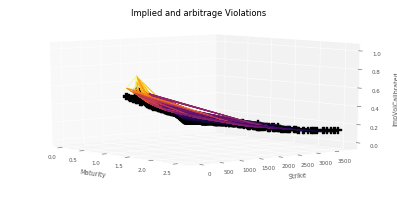

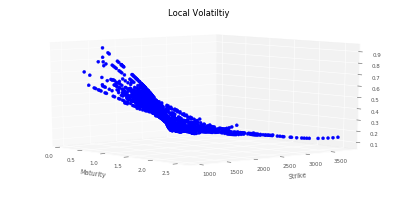

In [18]:
serieTest, dTTest, hkTest, dKTest, locVolSSVITest, densityTest = experiments.evalSSVIModel(dataSetTest, 
                                                                                           ssviModel, 
                                                                                           KMin, KMax, 
                                                                                           S0,
                                                                                           bootstrap, 
                                                                                           "SSVIConstrainedTesting")

#### Backtest Local volatility SSVI 


In [19]:
def neuralVolLocaleSSVI(s,t):
    volLocaleGrid = pd.DataFrame(np.vstack((np.ravel(s), np.ravel(t))).T, 
                                 columns = ["Strike", "Maturity"]).set_index(["Strike","Maturity"],drop=False)
    volLocaleGrid["ChangedStrike"] = bootstrap.changeOfVariable(volLocaleGrid["Strike"], volLocaleGrid["Maturity"])[0]
    volLocaleGrid["logMoneyness"] = np.log(volLocaleGrid["ChangedStrike"] / S0)
    volLocaleGrid["OptionType"] = np.ones_like(volLocaleGrid["logMoneyness"])
    
    _, _, _, locVolSSVI, _ = SSVI.finiteDifferenceSVI(volLocaleGrid, ssviModel.eval)
    return locVolSSVI.dropna()

In [31]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


./code/SSVI.py:1169: RuntimeWarning: invalid value encountered in sqrt
  locVolGatheral = np.sqrt(dT / numerator)


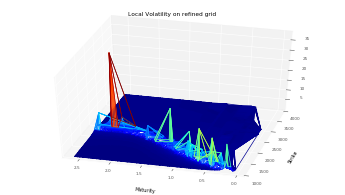

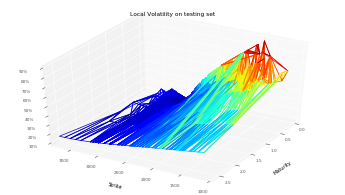

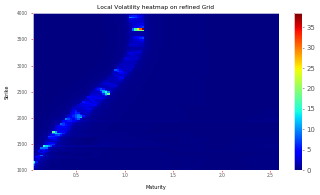

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


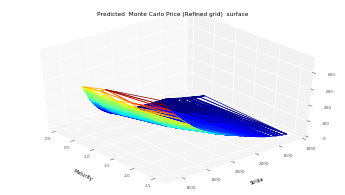

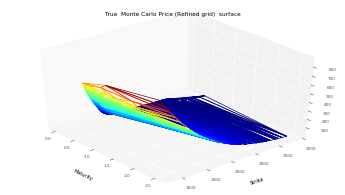

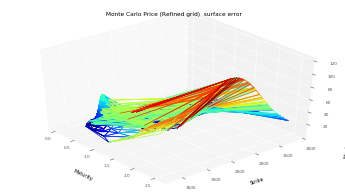

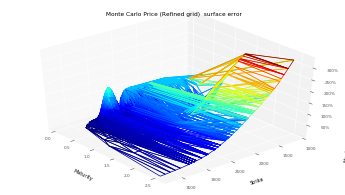

RMSE :  22.825834085263857
RMSE Relative:  0.6426344733155264


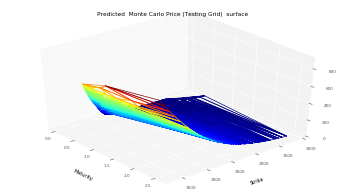

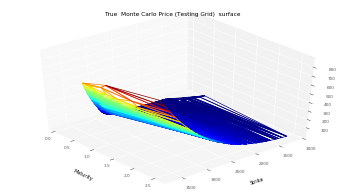

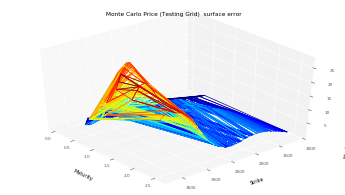

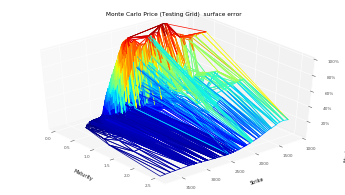

RMSE :  5.489683040924905
RMSE Relative:  0.295156011186774
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


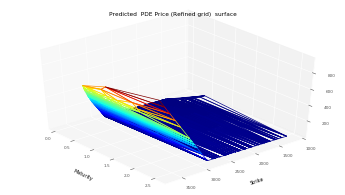

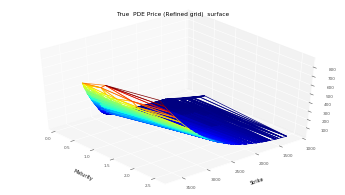

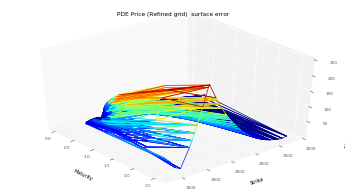

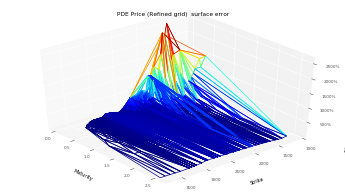

RMSE :  33.544942328465346
RMSE Relative:  2.2295832481406412


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


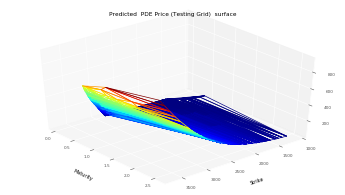

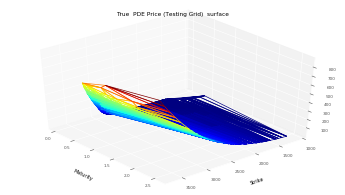

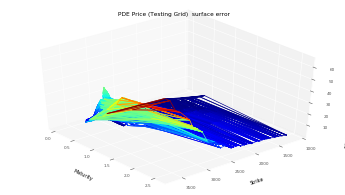

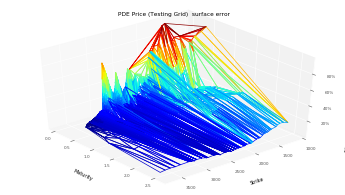

RMSE :  10.36420775134676
RMSE Relative:  0.24702365494060477


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [32]:
resBacktestSSVI = experiments.backTestLocalVolatility(neuralVolLocaleSSVI, 
                                                      volLocaleGridDf,
                                                      dataSetTest,
                                                      nbTimeStep,
                                                      nbPaths,
                                                      KMin,
                                                      KMax,
                                                      S0,
                                                      bootstrap,
                                                      "SSVI")
volLocalGridRefinedSSVI, volLocalGridTestSSVI, mcResVolLocaleRefinedSSVI, mcResVolLocaleTestSSVI, pdeResVolLocaleRefinedSSVI, pdeResVolLocaleTestSSVI = resBacktestSSVI

## GP Backtesting
The purpose of this section is to load the GP local volatility surface and perform the Monte-Carlo backtest of the option prices thanks to the GP local volatility surface. Note that the GP local volatility is generated by running the Matlab code in the "code/GP" folder. See Section "GP Local Volatility Backtests" below for further details of the backtests.

### Load GP Results

This section loads result from the Matlab experiments.
See code/GP folder to access the matlab script.

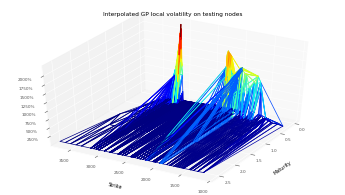

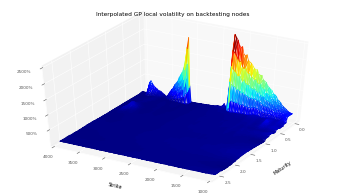

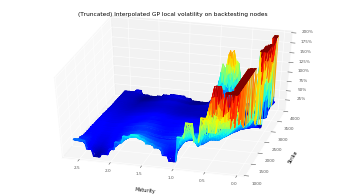

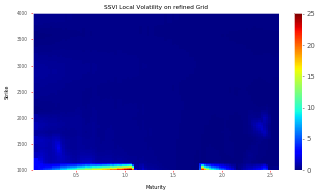

./code/experiments.py:794: RuntimeWarning: divide by zero encountered in log
  logMin = np.log(KMin/S0),


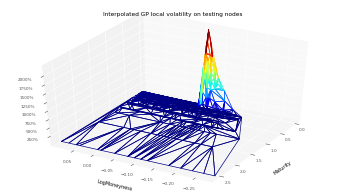

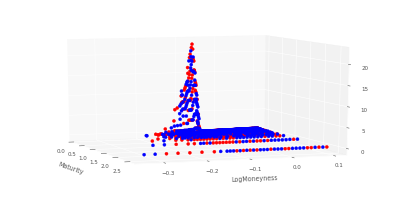

In [20]:
nnGP = experiments.loadGPResults(dataSet, dataSetTest, S0, bootstrap, KMin, KMax, volLocaleGridDf)

#### GP Local Volatility Backtests

In [6]:
nbTimeStep = 100
nbPaths = 10000

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


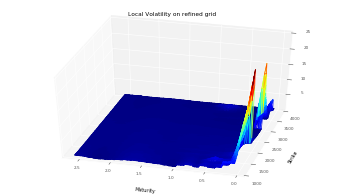

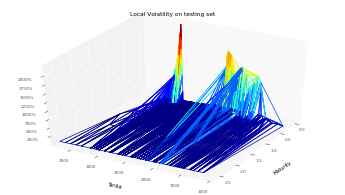

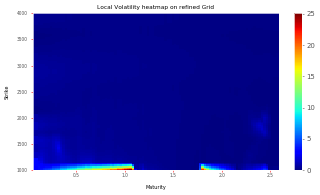

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


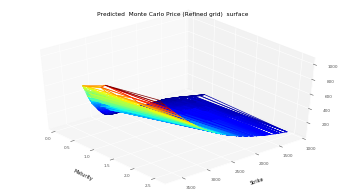

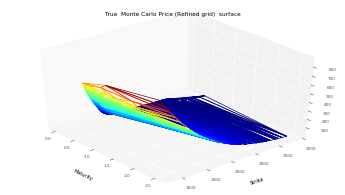

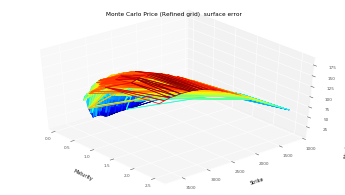

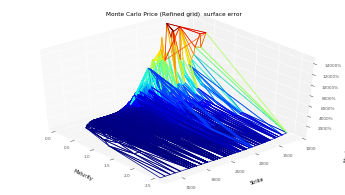

RMSE :  74.01710829569407
RMSE Relative:  17.877792599945277


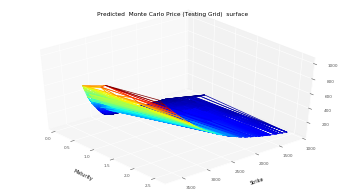

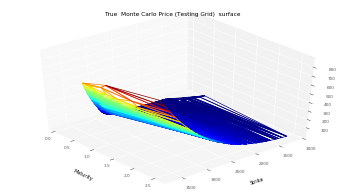

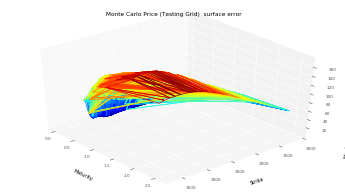

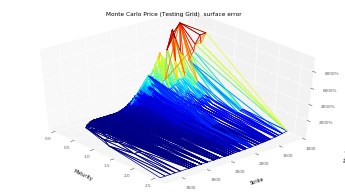

RMSE :  66.7473335325378
RMSE Relative:  11.93573312758809
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


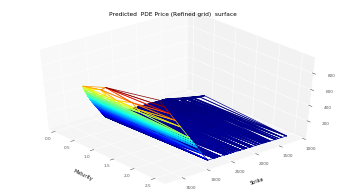

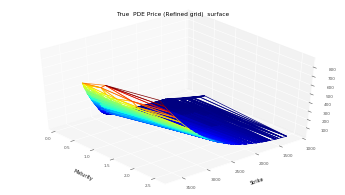

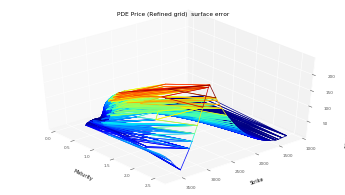

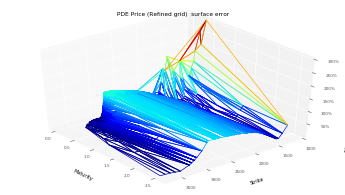

RMSE :  35.26978314020192
RMSE Relative:  0.7296470537537663


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


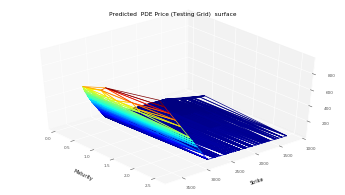

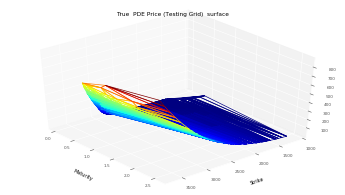

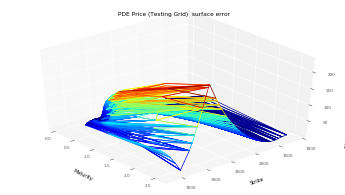

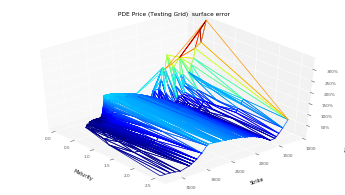

RMSE :  34.49411791539798
RMSE Relative:  0.7249979477254873


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


In [35]:
resBacktestGP = experiments.backTestLocalVolatility(nnGP,
                                                    volLocaleGridDf,
                                                    dataSetTest,
                                                    nbTimeStep,
                                                    nbPaths,
                                                    KMin,
                                                    KMax,
                                                    S0,
                                                    bootstrap,
                                                    "GP")
volLocalGridRefinedGP, volLocalGridTestGP, mcResVolLocaleRefinedGP, mcResVolLocaleTestGP, pdeResVolLocaleRefinedGP, pdeResVolLocaleTestGP = resBacktestGP

# Results Comparison


Loading GP results : 
Loading Neural results : 
Loading Neural results with price: 
Loading SSVI results : 
-----------------------------------------------------------------------------------------------------------------
Plotting constrained implied volatilities : 


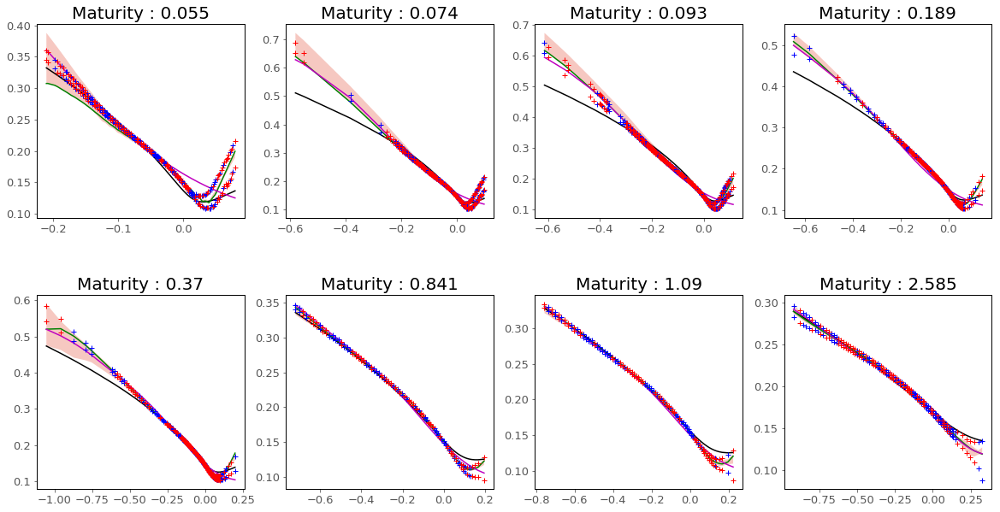

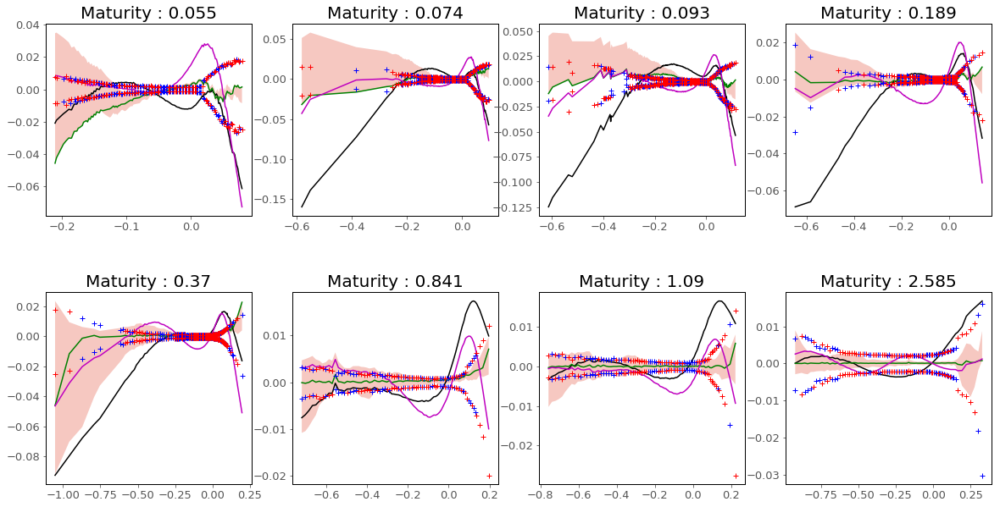

-----------------------------------------------------------------------------------------------------------------
Plotting unconstrained implied volatilities : 


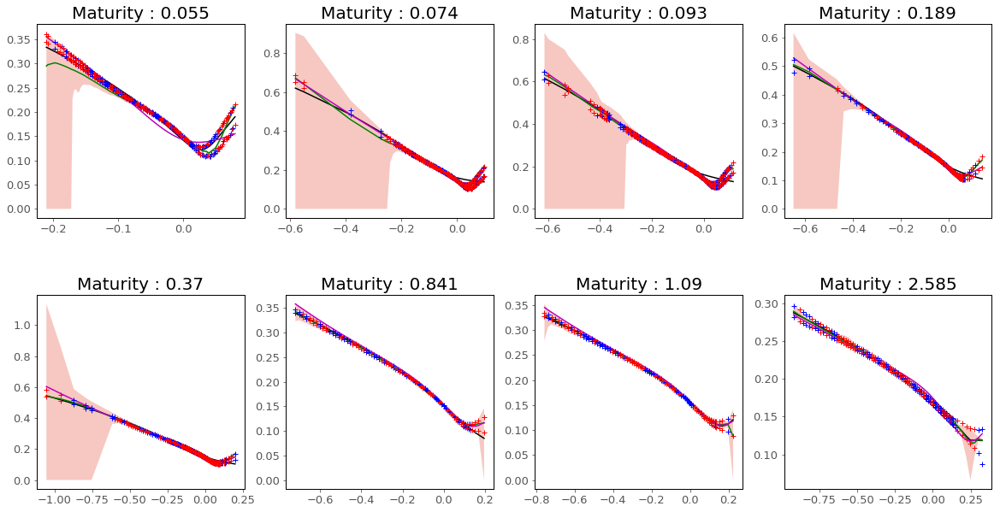

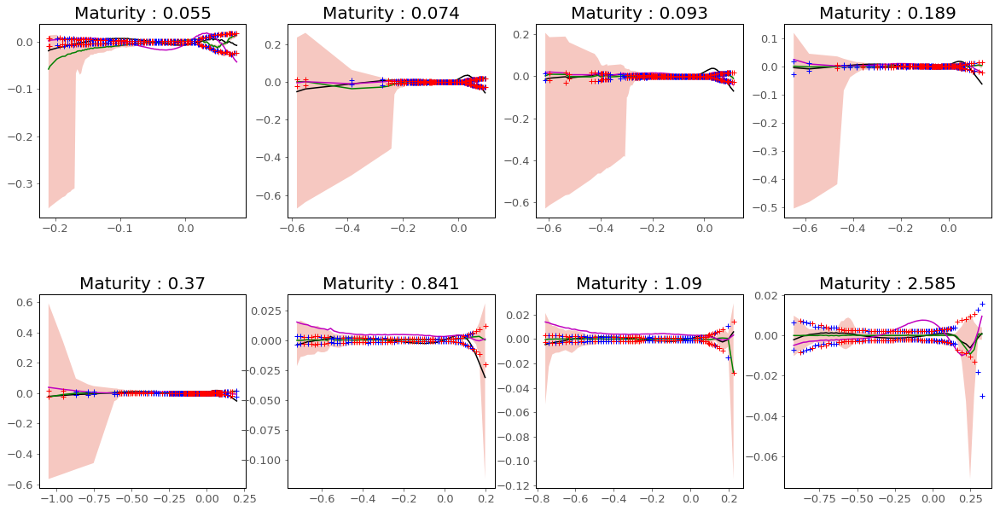

-----------------------------------------------------------------------------------------------------------------
Plotting constrained Price : 


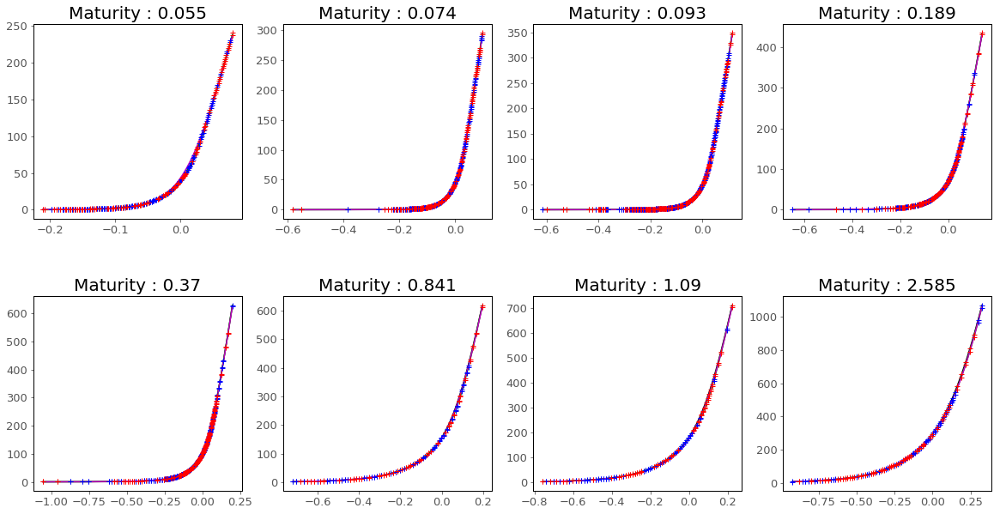

-----------------------------------------------------------------------------------------------------------------
Plotting unconstrained Price : 


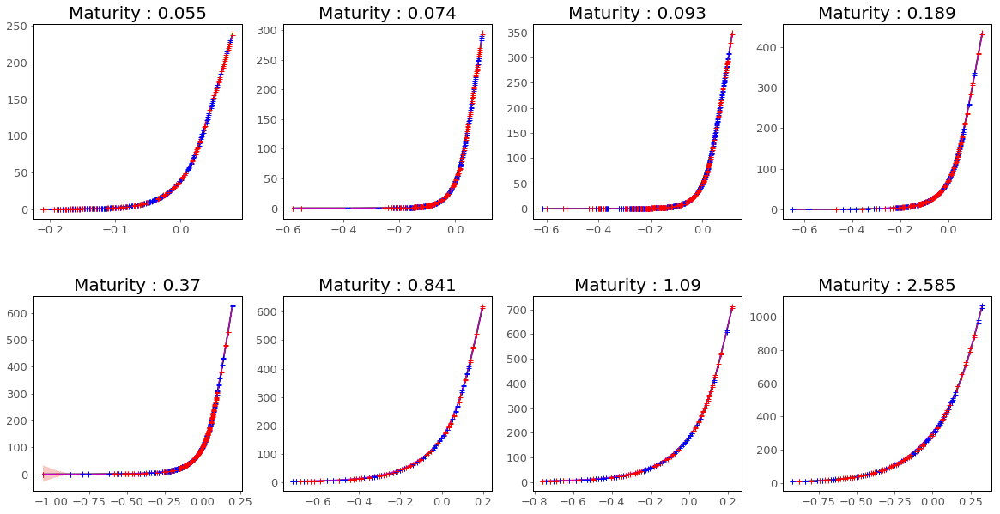

-----------------------------------------------------------------------------------------------------------------
Summarize RMSEs : 
Absolute Price RMSEs


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained,Neural Network with price Unconstrained
Train,2.574,0.338,2.897,9.851,2.691,0.321,2.163,2.456
Test,2.892,0.355,2.966,10.347,2.791,0.477,2.045,2.888


Relative Price RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained,Neural Network with price Unconstrained
Train,17.01,5.67,10.65,616.81,8.03,5.52,12.81,128.57
Test,17.81,7.00,11.27,904.50,9.07,6.81,13.75,153.34


Absolute Implied volatility RMSEs


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained,Neural Network with price Unconstrained
Train,0.0137,0.0058,0.0123,0.1370,0.0104,0.0060,0.0084,0.0565
Test,0.0152,0.0057,0.0129,0.1427,0.0109,0.0057,0.0086,0.0614


Relative Implied volatility RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price,SSVI Unconstrained,GP Unconstrained,Neural Network Unconstrained,Neural Network with price Unconstrained
Train,6.55,4.15,8.33,46.84,7.59,4.19,4.99,21.69
Test,6.89,3.65,8.52,46.98,7.67,3.70,4.88,23.53


Absolute Price backtesting RMSEs


,SSVI,GP,Neural Network,Neural Network with price
Monte Carlo,22.826,74.017,4.989,11.764
PDE,33.545,35.270,11.976,26.785


Relative Price backtesting RMSEs (%)


,SSVI,GP,Neural Network,Neural Network with price
Monte Carlo,64.26,1787.78,45.04,56.92
PDE,222.96,72.96,28.29,61.38


Absolute Implied Vol backtesting RMSEs


,SSVI,GP,Neural Network,Neural Network with price
Monte Carlo,0.0869,0.1976,0.0637,0.0624
PDE,0.0688,0.0786,0.0343,0.0556


In [11]:
experiments.compareResults(dataSet, dataSetTest, S0, bootstrap)

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Estimating local volatility
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


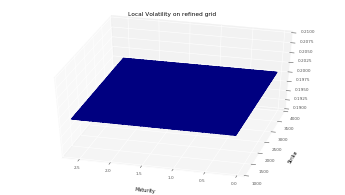

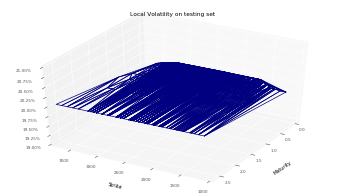

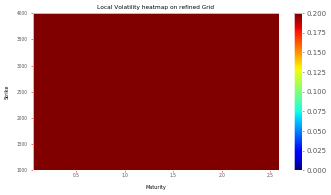

------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
Monte Carlo Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


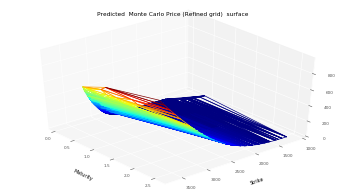

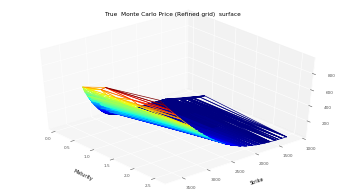

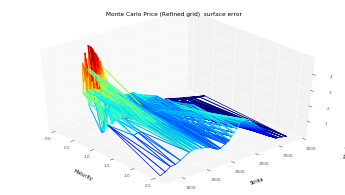

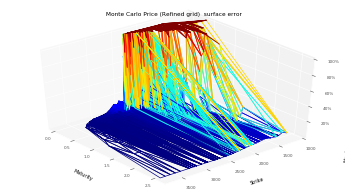

RMSE :  1.5870689721361388
RMSE Relative:  0.33321075893687546


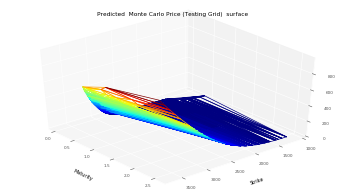

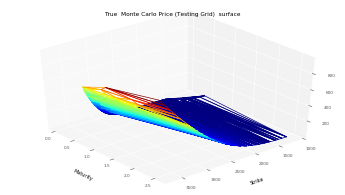

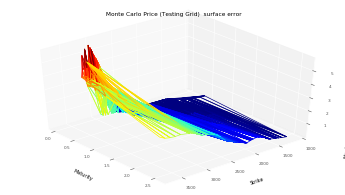

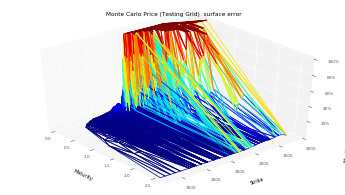

RMSE :  1.8334827579804183
RMSE Relative:  0.3383265650820789
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------
PDE Backtest
------------------------------------------------------------------------------------
------------------------------------------------------------------------------------


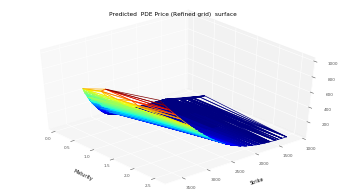

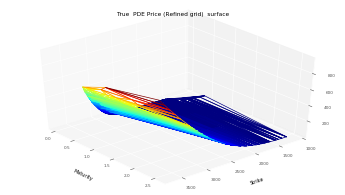

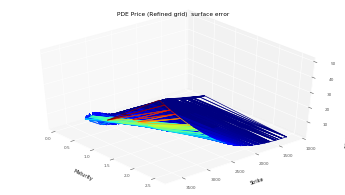

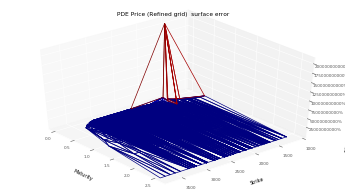

RMSE :  4.097711807278742
RMSE Relative:  50638745.83250338


./code/experiments.py:375: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleRefined.to_csv(workingFolder + "pdeResVolLocaleRefined" + modelName + ".csv")


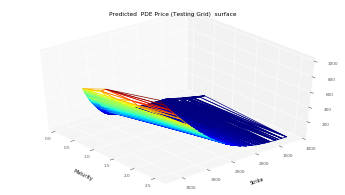

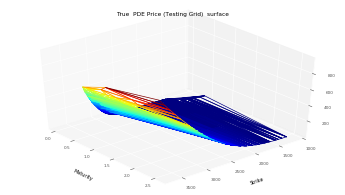

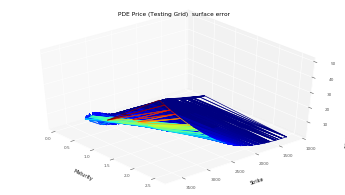

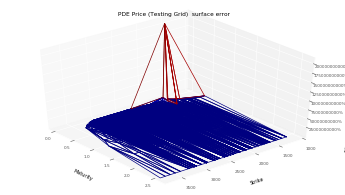

RMSE :  4.0977118072787135
RMSE Relative:  50638745.83250338


./code/experiments.py:387: FutureWarning: The signature of `Series.to_csv` was aligned to that of `DataFrame.to_csv`, and argument 'header' will change its default value from False to True: please pass an explicit value to suppress this warning.
  pdeResVolLocaleTest.to_csv(workingFolder + "pdeResVolLocaleTest" + modelName + ".csv")


Implied vol RMSE Monte Carlo Refined Grid:  0.028969728961684458
Implied vol RMSE Monte Carlo Testing Grid:  0.02834262178842188
Implied vol RMSE PDE Refined Grid:  0.00845738242493923
Implied vol RMSE PDE Testing Grid:  0.00845738242493923


In [11]:
#Sanity check for backtest with a flat local volatility surface equal to 0.2.
experiments.backTestUnitTest(volLocaleGridDf,
                             dataSetTest,
                             nbTimeStep,
                             nbPaths,
                             KMin,
                             KMax,
                             S0,
                             bootstrap,
                             0.2)
